# Slightly improved Generative Adversarial Network

The objective here is to experiment in implementing some minor improvements to a really basic GAN (Generative Adversarial Network) in Pytorch. The GENERATOR of the GAN will learn (hopefully) to generate grayscale handwritten digits.

Improve with W-loss as from the article:
https://arxiv.org/abs/1701.07875

The training dataset is the classical MNIST dataset (available in PyTorch, so the code doesn't need too much data preprocessing). It contains 60,000 images (28x28) of handwritten digits, from 0 to 9, in grayscale (only 1 channel).

#### Import Packages

In [ ]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms

from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt

from torchvision.datasets import MNIST #import the MNIST dataset

#### Generator architecture

In [ ]:
# Define the generator class

# INPUTS
# noise_dim: An integer, the dimension of the noise vector
# image_channels: An integer, the number of channels in the images (default 1)
# hidden_dim: An integer, the hidden dimension of the generator that's gonna scale up (we try a really basic architecture)

class Generator(nn.Module):
    def __init__(self, noise_dim=10, image_channels=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.noise_dim = noise_dim
        # sequence of blocks of the Generator
        self.gen = nn.Sequential(
            self.generator_block(noise_dim, hidden_dim * 4),
            self.generator_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.generator_block(hidden_dim * 2, hidden_dim),
            self.generator_block(hidden_dim, image_channels, kernel_size=4, final_layer=True),
        )

    # function that returns a single block of the Generator,
    # INPUTS:
    # number of channels of the input image, channels of the output image
    # parameters of the convolution layer
    # A boolean "final_layer", indicating if the block is the final block of the Generator

    def generator_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        if not final_layer: # generic block that is not the last
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:  #define the last block without BatchNorm and with tanh
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    # function that completes a forward pass through the generator, takes as input a noise
    # vector of dimesnions (n_samples, noise_dim), returns generated images
    def forward(self, noise):
        x = noise.view(len(noise), self.noise_dim, 1, 1)
        return self.gen(x)

#### Discriminator architecture



In [ ]:
#Define the Discriminator class

class Discriminator(nn.Module):
    def __init__(self, image_channels=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.discr = nn.Sequential(
            self.discriminator_block(image_channels, hidden_dim),
            self.discriminator_block(hidden_dim, hidden_dim * 2),
            self.discriminator_block(hidden_dim * 2, 1, final_layer=True),
        )
    # look at the Generator for explanation of the inputs
    def discriminator_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )
    def forward(self, image):
        discr_pred = self.discr(image)
        return discr_pred.view(len(discr_pred), -1)

#### Initialization

In [ ]:
# Set the device: checks availability of GPU, in case it is available device is set
# to GPU, otherwise CPU.

if torch.cuda.is_available():
    device = torch.device("cuda")
    print("GPU available")
else:
    device = torch.device("cpu")
    print("GPU not available, using CPU, we are poors bro!")

# Initialize Hyperparameters

n_epochs = 100
noise_dim = 64                 # Dimension of noise vector

batch_size = 128
learning_rate = 0.0002                # Learning rate
beta_1 = 0.5               # For Adam optimization
beta_2 = 0.999             # For Adam optimization
lambda_coeff = 10              # For gradient penalties
discr_repeats = 5          # number of repetitions for the discriminator

display_step = 500         # For visualization purposes

# Normalize and preprocess the images
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

# Load the training dataset

dataloader = DataLoader(
    MNIST('.', download=True, transform=transform),
    batch_size=batch_size,
    shuffle=True)

# Initialize generator

gen = Generator(noise_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=learning_rate, betas=(beta_1, beta_2))

# Initialize discriminator

discr = Discriminator().to(device)
discr_opt = torch.optim.Adam(discr.parameters(), lr=learning_rate, betas=(beta_1, beta_2))

# Function that initializes the weights for generator and discriminator
# Weights inizialization with a normal distribution
# Helps with stability and convergence of training in GANS

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)

# Apply the function to generator and discriminator
gen = gen.apply(weights_init)
discr = discr.apply(weights_init)

GPU available


100%|██████████| 9912422/9912422 [00:00<00:00, 30508685.56it/s]


Extracting ./MNIST/raw/train-images-idx3-ubyte.gz to ./MNIST/raw



100%|██████████| 28881/28881 [00:00<00:00, 119936330.52it/s]


Extracting ./MNIST/raw/train-labels-idx1-ubyte.gz to ./MNIST/raw



100%|██████████| 1648877/1648877 [00:00<00:00, 41182689.40it/s]


Extracting ./MNIST/raw/t10k-images-idx3-ubyte.gz to ./MNIST/raw



100%|██████████| 4542/4542 [00:00<00:00, 24967927.61it/s]

Extracting ./MNIST/raw/t10k-labels-idx1-ubyte.gz to ./MNIST/raw



#### Improvements with Gradient penalties

In [ ]:
# Function to compute the gradients and gradient penalties

# Return the gradient of the discriminator's scores with respect to mixes of real and fake images.

# Inputs:
# discr: the discriminator model
# real: batch of real images
# fake: batch of fake images
# epsilon: a vector of the uniformly random proportions of real/fake per mixed image

def compute_gradient(discr, real, fake, epsilon):

    mixed_images = real * epsilon + fake * (1 - epsilon)   # Mix the images together

    mixed_scores = discr(mixed_images)     # Calculate the discriminator's scores on the mixed images

    gradient = torch.autograd.grad(      # Take the gradient of the scores with respect to the images
        inputs=mixed_images,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient

# Function to compute the gradient penalties given the gradient

def gradient_penalty(gradient):

    gradient = gradient.view(len(gradient), -1)  # Flatten the gradients so that each row has one image

    gradient_norm = gradient.norm(2, dim=1)  # Calculate the norm of every row

    # compute the gradient penalty as distance of its norm from one, take the mean on the batch at the end.
    penalty = ((gradient_norm -1)**2).mean()

    return penalty

#### Improvements with loss functions

In [ ]:
# Compute loss for Generator
# Return the loss of the generator given the discriminator's scores of the generator's fake images

def compute_gen_loss(discr_fake_pred):
    gen_loss = -discr_fake_pred.mean()
    return gen_loss

# Compute loss for the Discriminator
# Return the loss of the discriminator
# INPUTS:
# discr_fake_pred: the discriminator's scores of the fake images
# discr_real_pred: the discriminator's scores of the real images
# grad_penalty: gradient penalty
# lambda_coeff: coefficient of the gradient penalty

def compute_discr_loss(discr_fake_pred, discr_real_pred, grad_penalty, lambda_coeff):
    discr_loss = - (discr_real_pred.mean() - discr_fake_pred.mean()) + lambda_coeff * grad_penalty  #written like this to resemble binary crossentropy
    return discr_loss

#### helper functions to visualize images

In [ ]:
# Given a tensor of images, number of images, and
# size per image, prints the images in an uniform grid.

def show_images(image_tensor, num_images=25, size=(1, 28, 28)):
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

# function to kep track of gradient
# use model.apply(grad_hook)
def make_grad_hook():
    grads = []
    def grad_hook(m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            grads.append(m.weight.grad)
    return grads, grad_hook

#### Training finally!

Better to do it on a GPU, or otherwise take a long walk while it is training! :)
It should avoid mode collapsing (i.e. generating always ones).

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 1, step 500: Generator loss: -1.2709137309435754, discriminator loss: -96.90264500377181


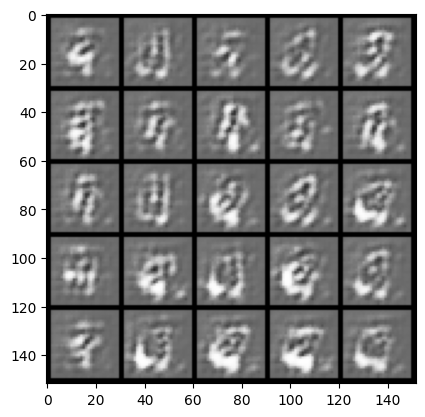

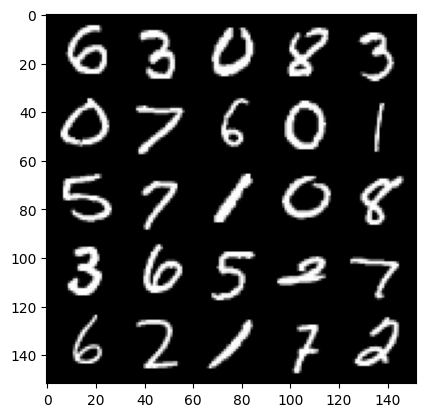

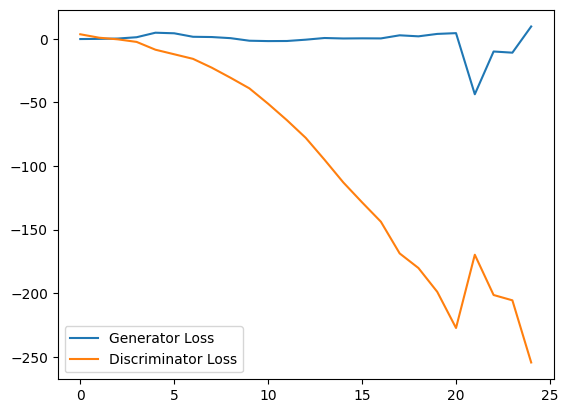

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 2, step 1000: Generator loss: -26.54397384840995, discriminator loss: -294.2160796775816


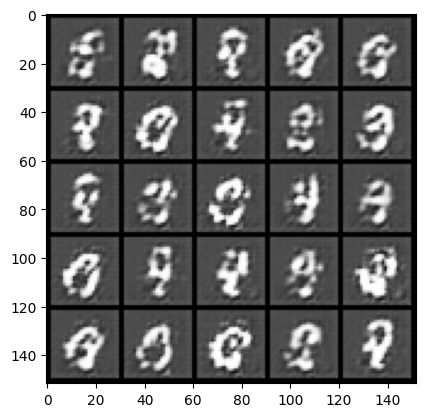

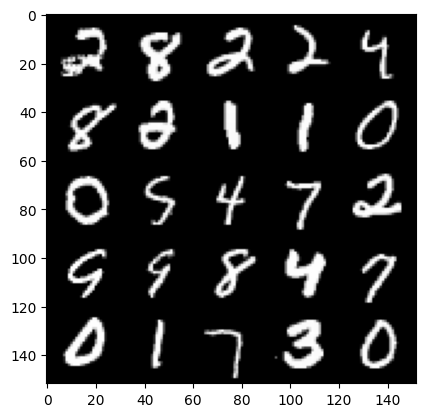

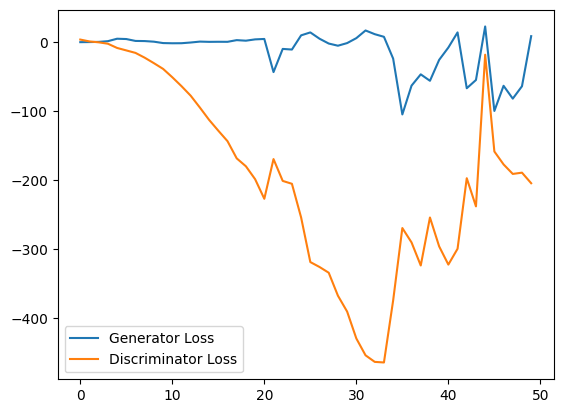

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 3, step 1500: Generator loss: -7.6410016686916356, discriminator loss: -47.91145707378385


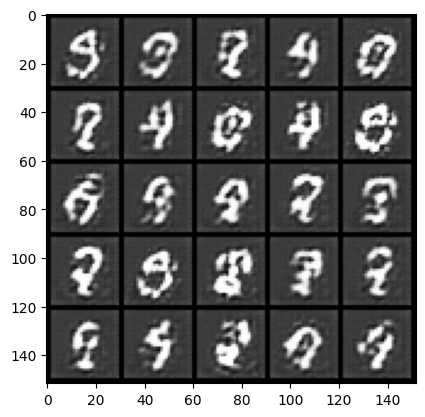

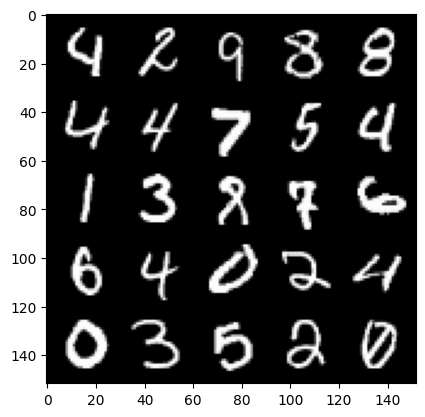

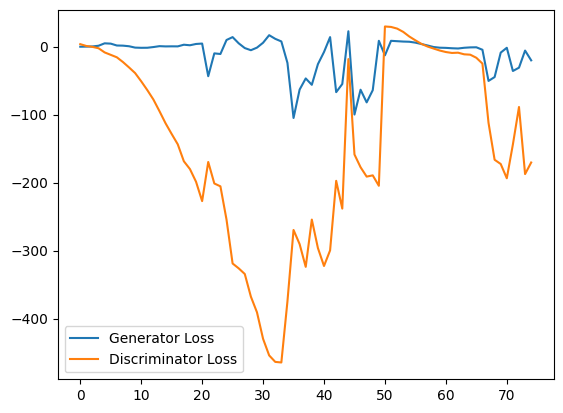

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 4, step 2000: Generator loss: 2.508221161544323, discriminator loss: -14.178127610778812


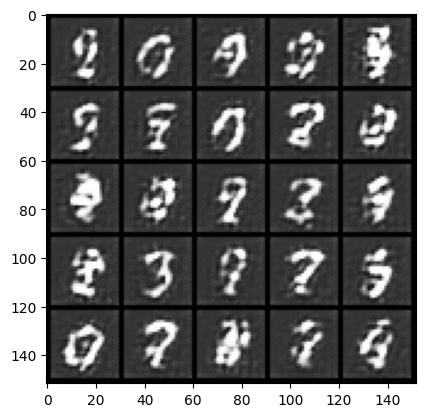

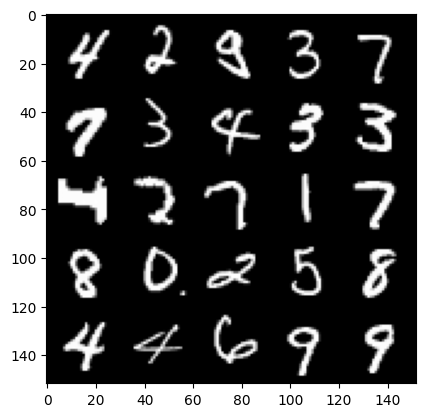

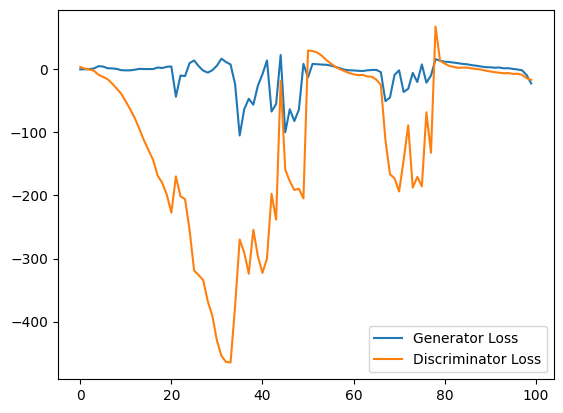

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 5, step 2500: Generator loss: -3.4110790217220783, discriminator loss: -35.951106015777626


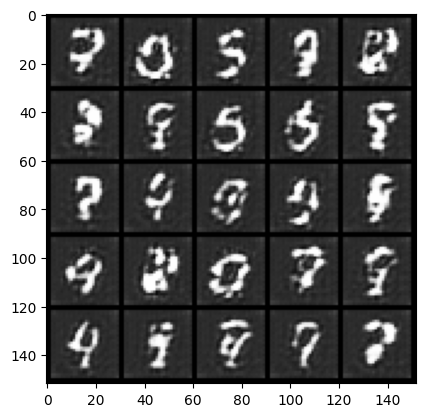

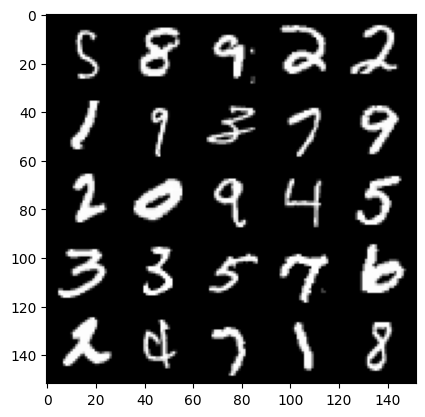

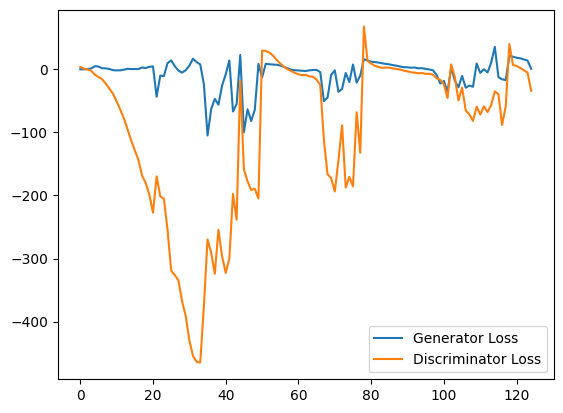

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 6, step 3000: Generator loss: -0.1235822831094265, discriminator loss: -40.46882628059388


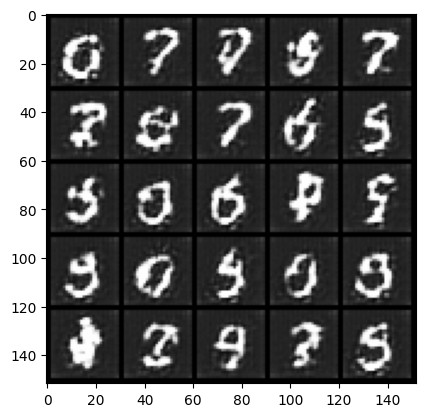

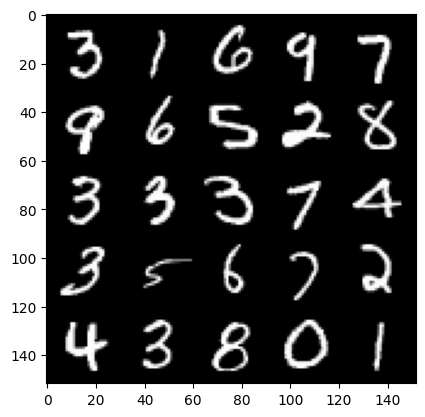

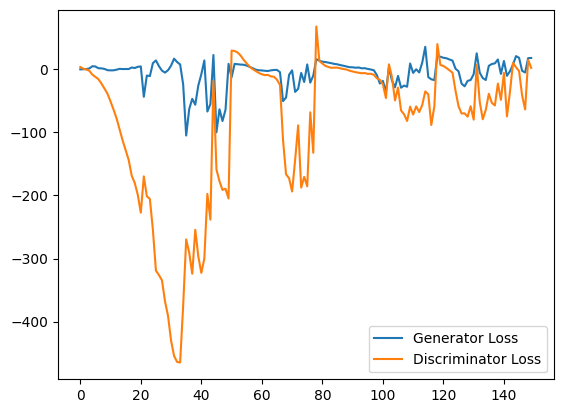

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 7, step 3500: Generator loss: 13.863295266151429, discriminator loss: -7.765684563064576


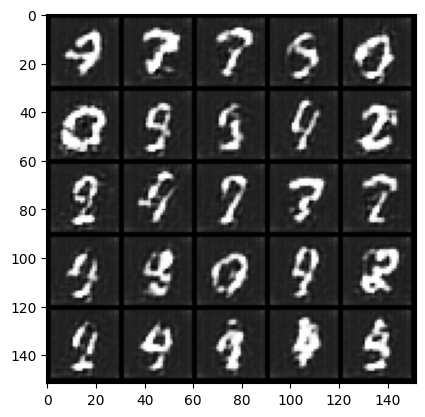

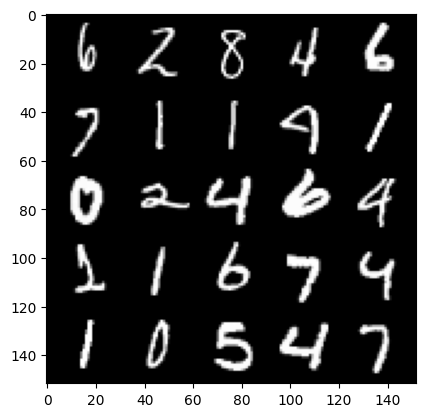

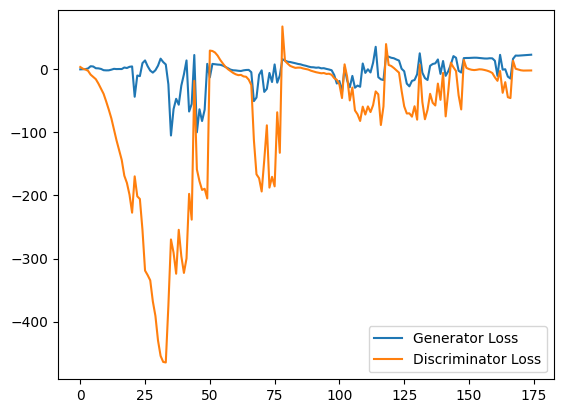

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 8, step 4000: Generator loss: 19.41566464781761, discriminator loss: -1.736070299100876


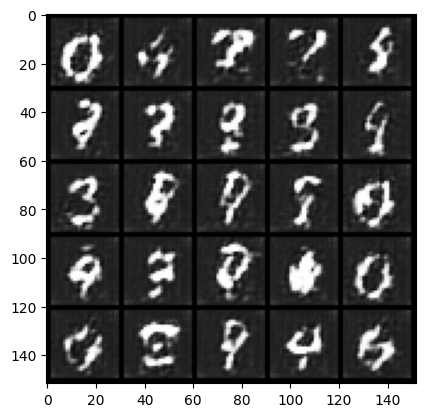

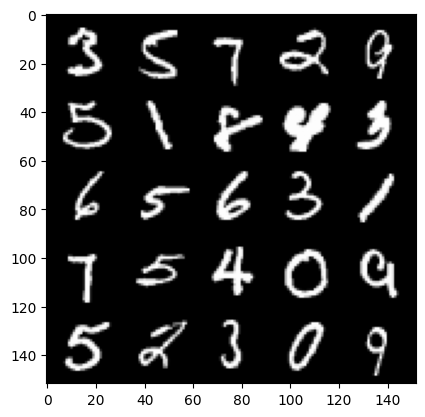

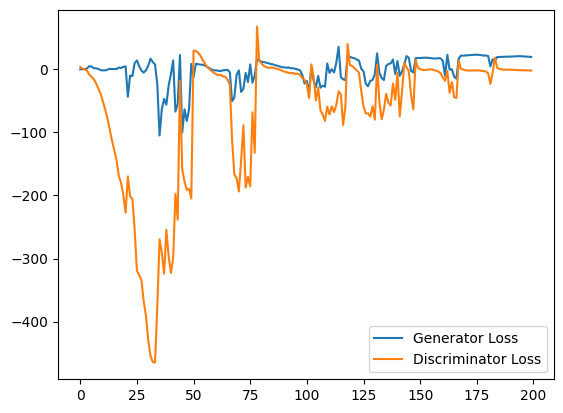

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 9, step 4500: Generator loss: 13.903373109206557, discriminator loss: -5.046034039497379


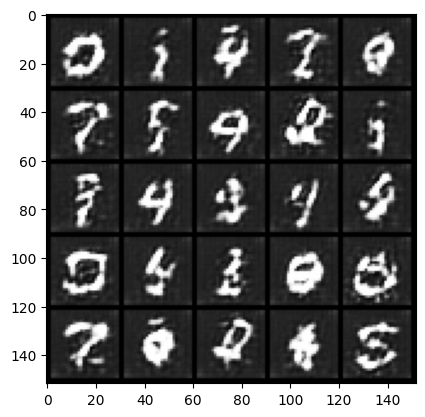

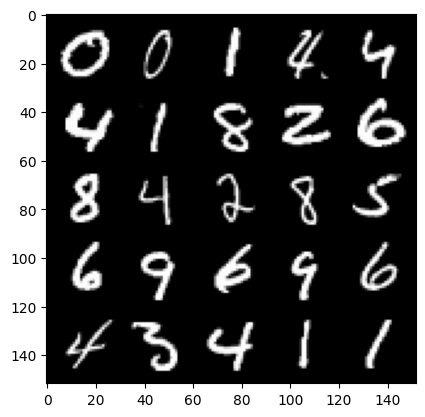

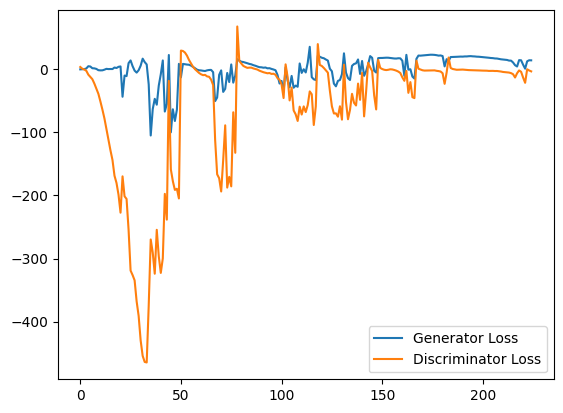

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 10, step 5000: Generator loss: 2.173617285311222, discriminator loss: -17.555934232664118


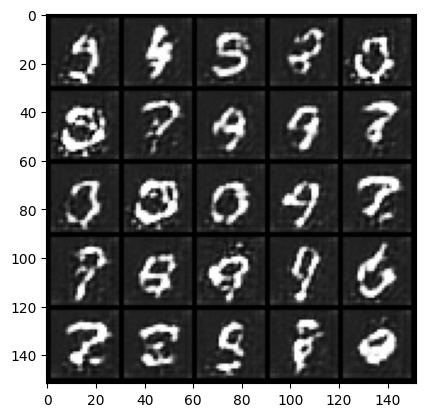

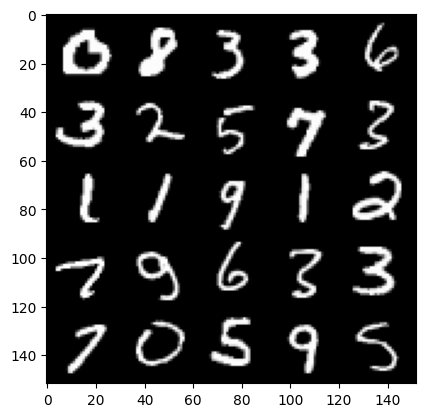

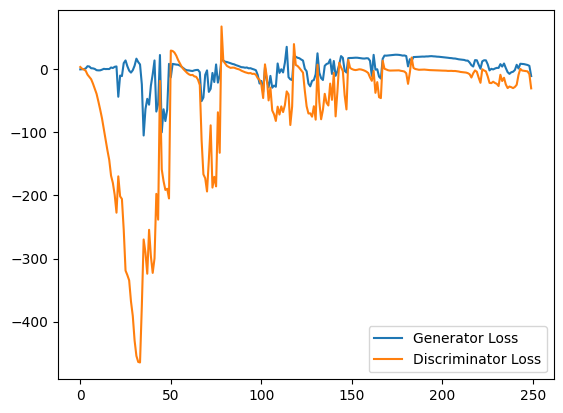

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 11, step 5500: Generator loss: -4.123702183827758, discriminator loss: -26.28956399917604


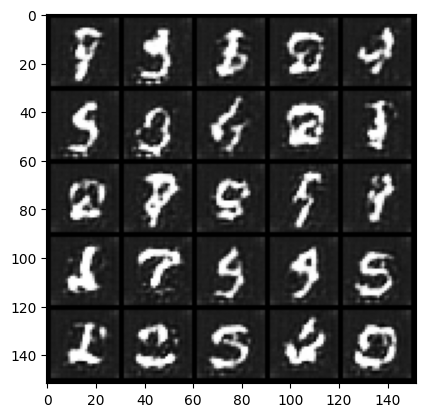

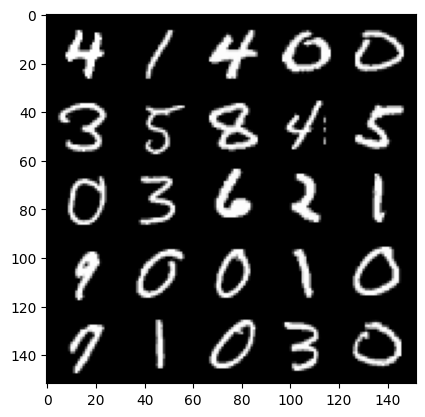

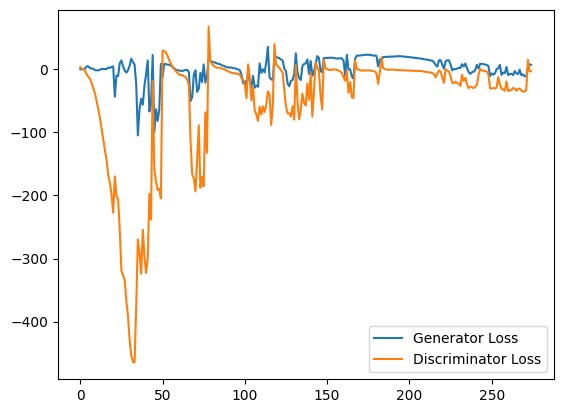

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 12, step 6000: Generator loss: -0.40096065909415485, discriminator loss: -12.461430569028849


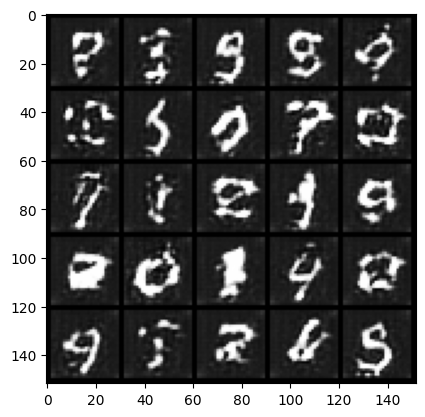

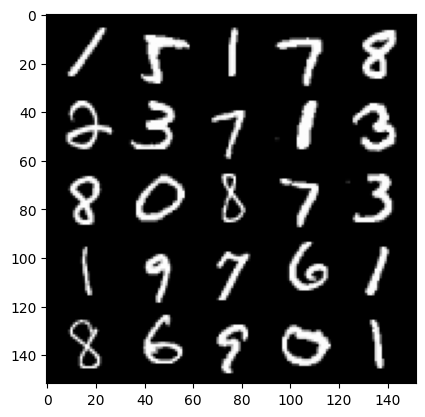

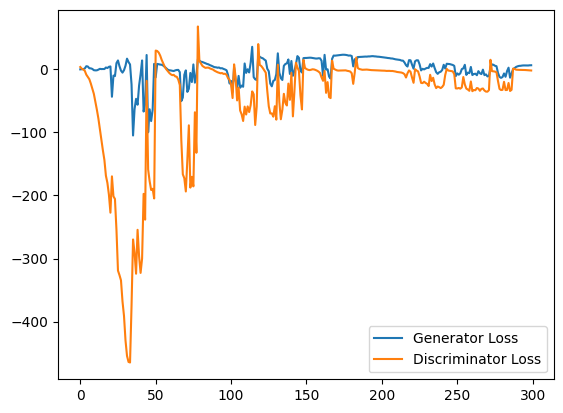

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 13, step 6500: Generator loss: 6.234061045408249, discriminator loss: -6.927700447273249


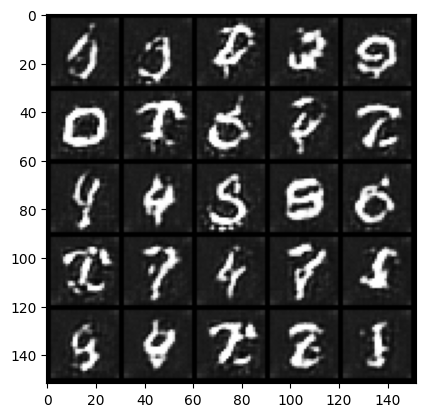

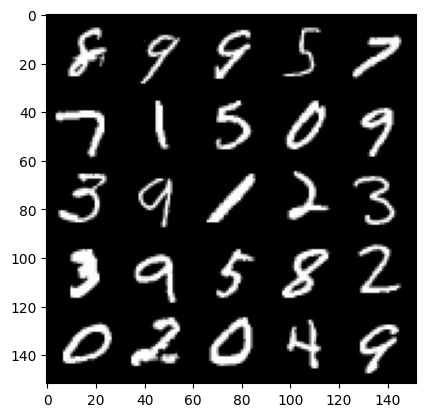

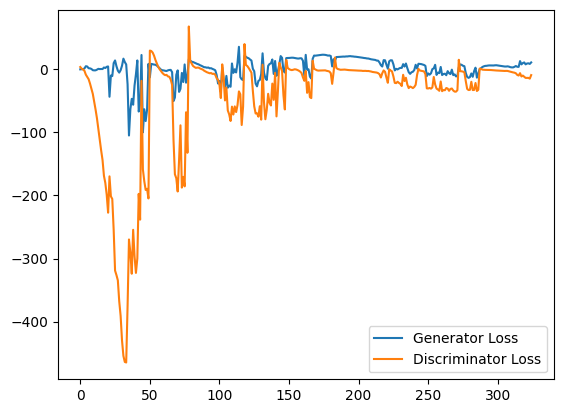

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 14, step 7000: Generator loss: 8.389991891622543, discriminator loss: -16.471600487613674


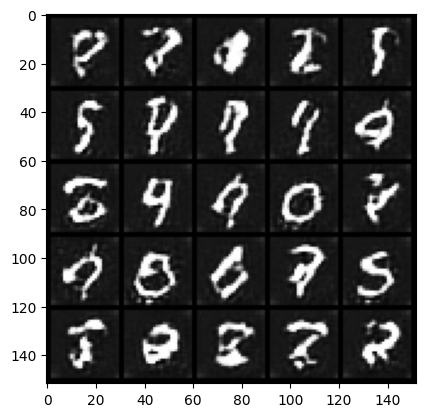

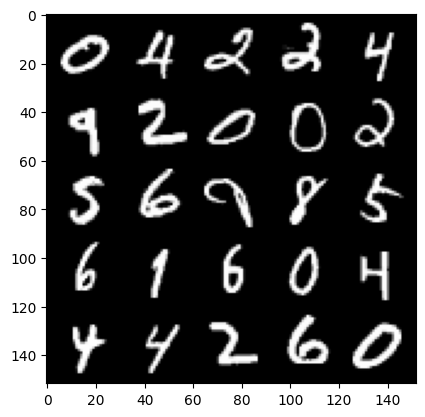

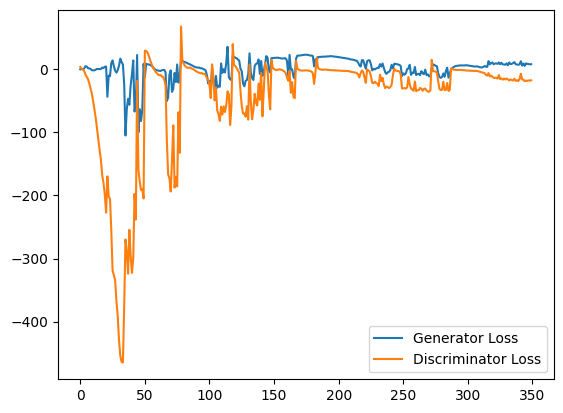

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 15, step 7500: Generator loss: 7.612758326917887, discriminator loss: -13.168575079751013


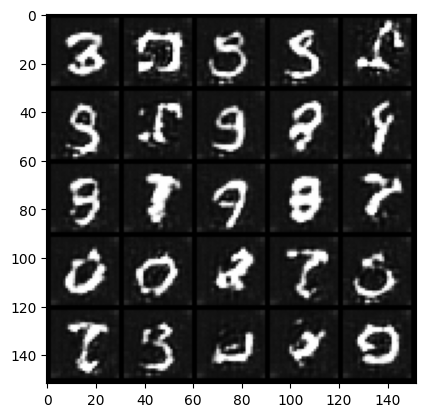

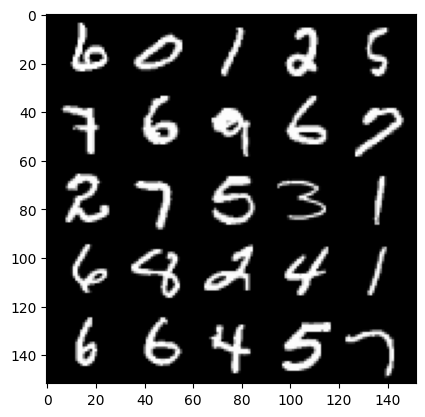

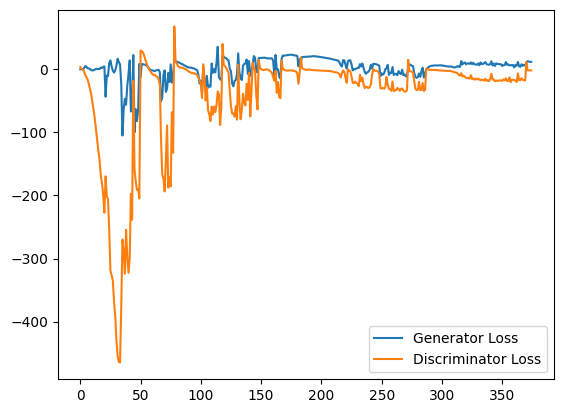

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 17, step 8000: Generator loss: 7.257137423753738, discriminator loss: -8.535797678709034


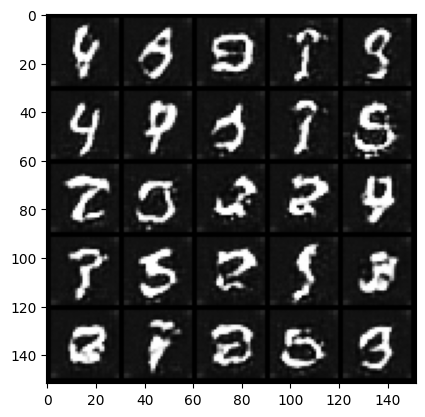

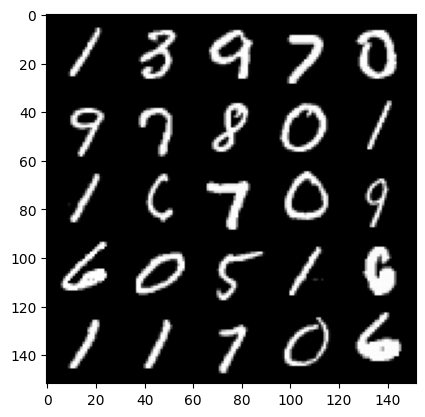

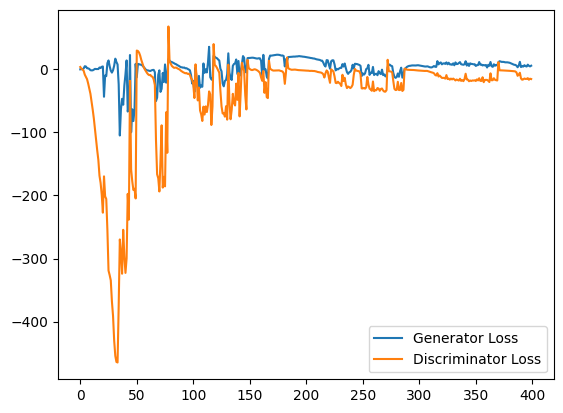

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 18, step 8500: Generator loss: 7.19283532935381, discriminator loss: -15.09083882536889


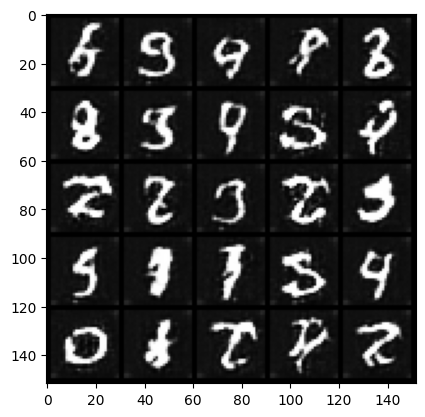

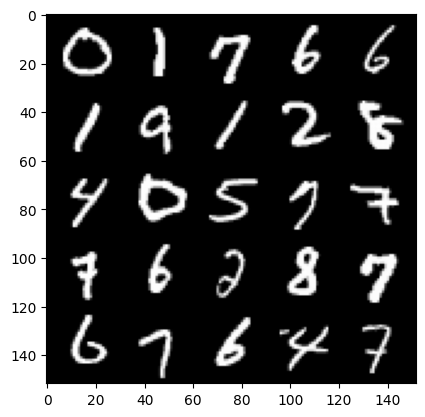

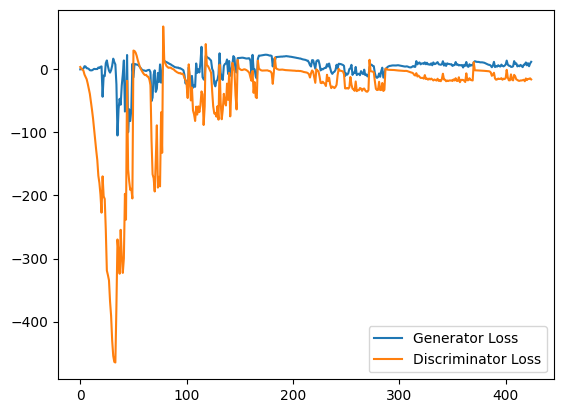

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 19, step 9000: Generator loss: 8.403300835356116, discriminator loss: -12.90779471693038


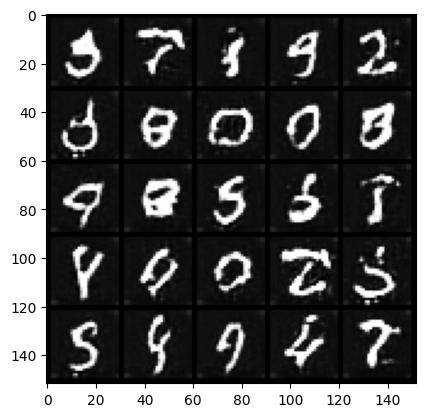

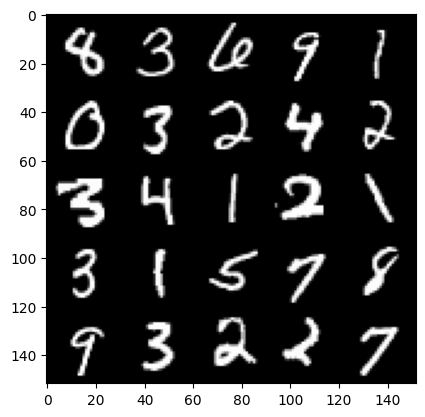

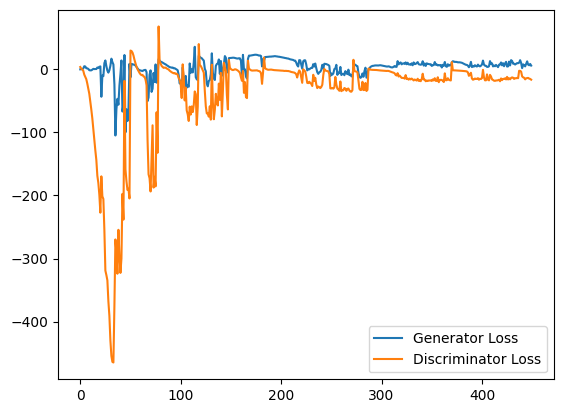

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 20, step 9500: Generator loss: 7.603262012988329, discriminator loss: -9.444198640012731


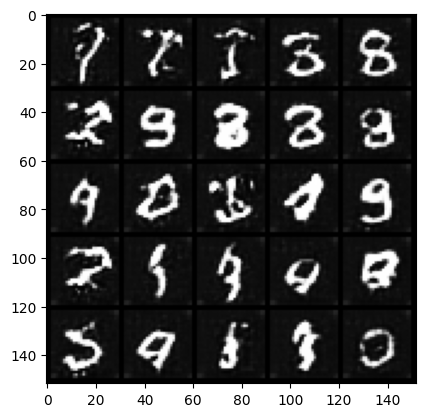

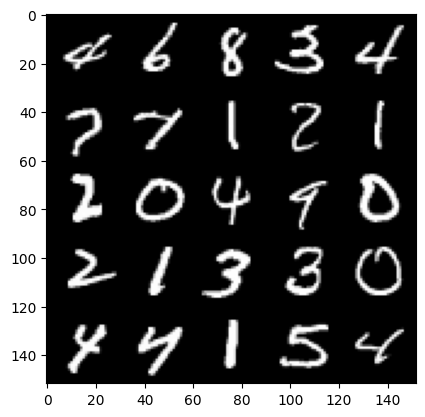

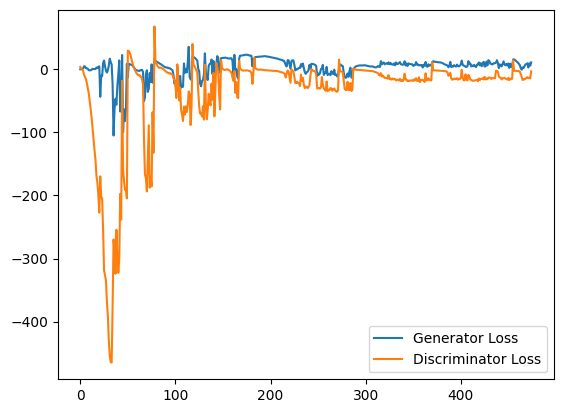

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 21, step 10000: Generator loss: 4.541353566646576, discriminator loss: -11.927811987066269


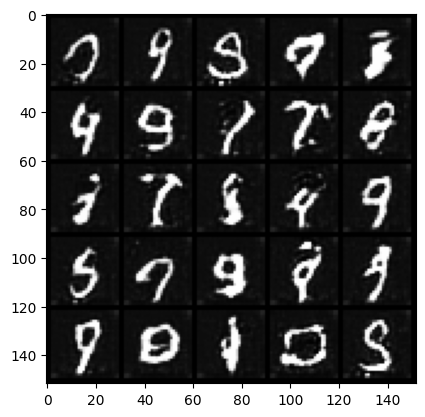

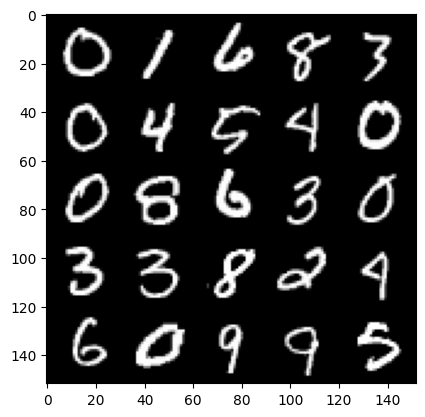

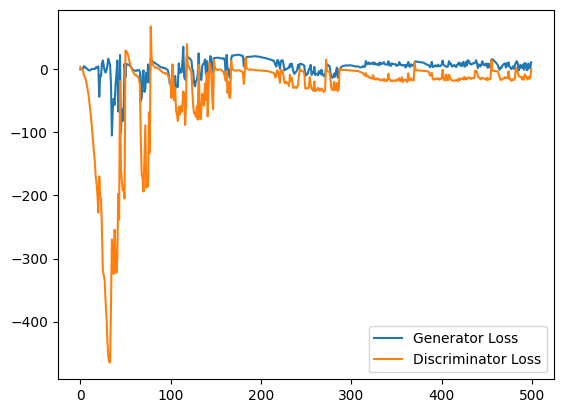

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 22, step 10500: Generator loss: 1.5107872235402464, discriminator loss: -14.314222335648536


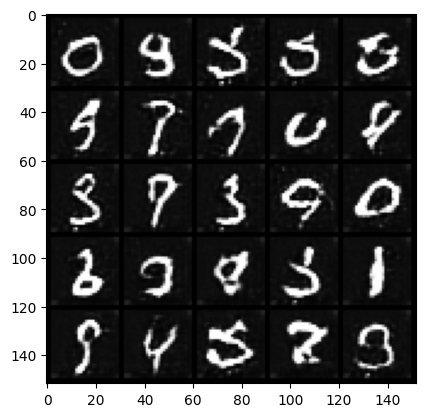

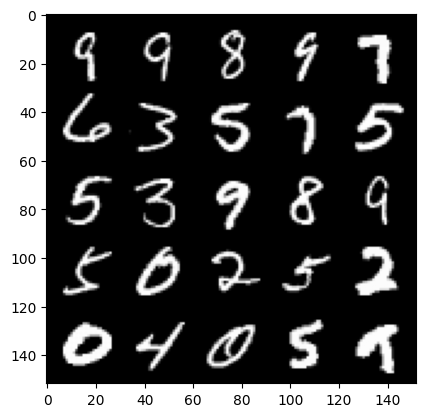

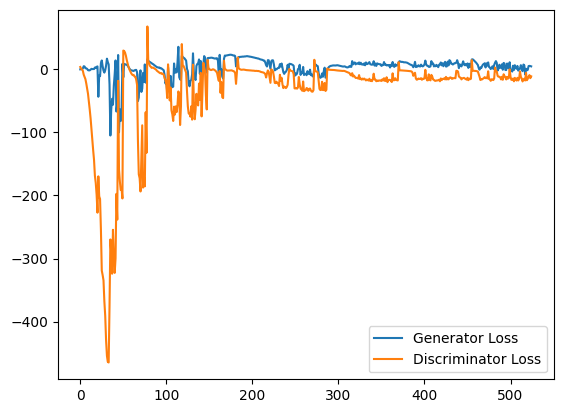

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 23, step 11000: Generator loss: 0.195500424310565, discriminator loss: -13.33853666820526


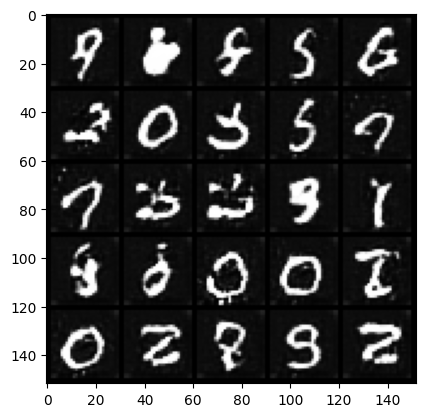

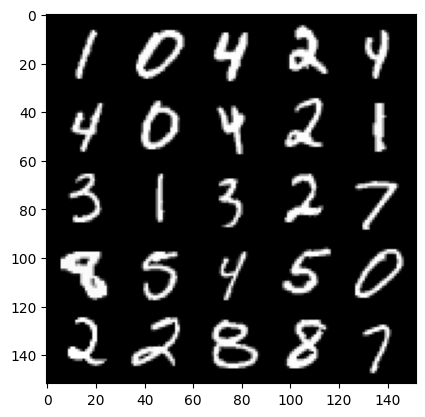

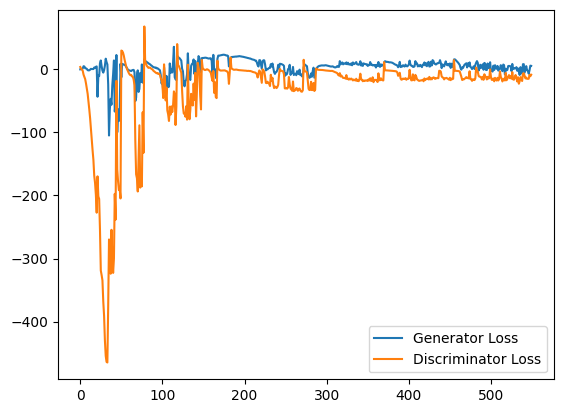

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 24, step 11500: Generator loss: 0.40801234293729066, discriminator loss: -12.796651889669901


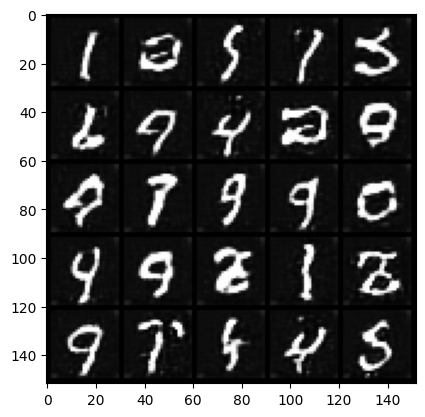

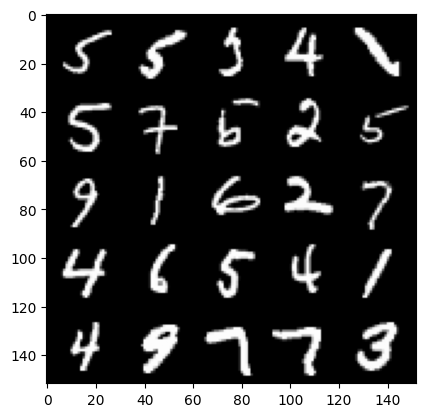

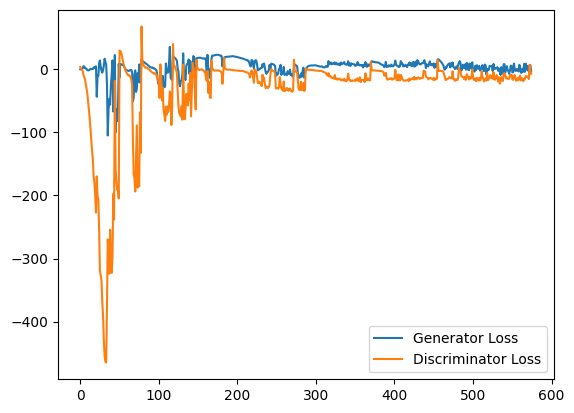

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 25, step 12000: Generator loss: -1.4740563496053218, discriminator loss: -14.832445217370983


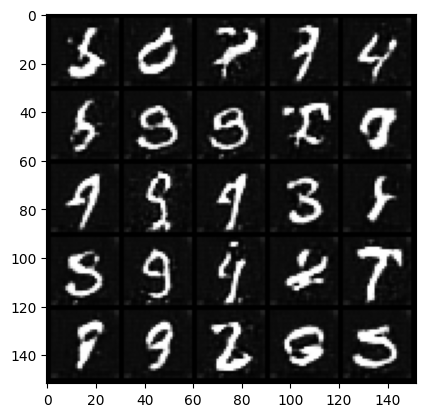

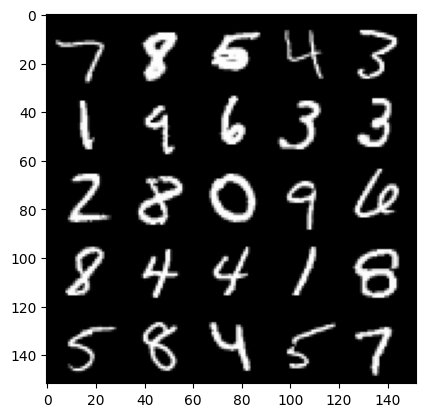

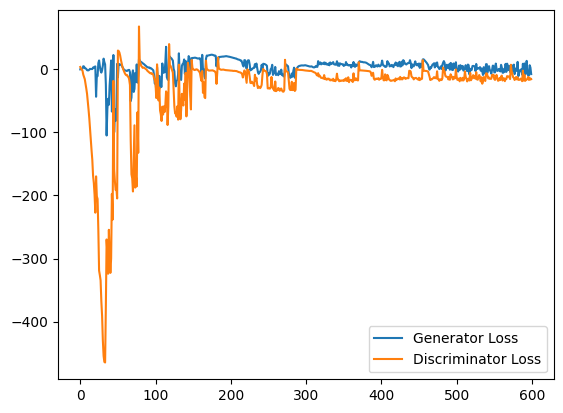

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 26, step 12500: Generator loss: -4.4006356575638055, discriminator loss: -13.247441282868374


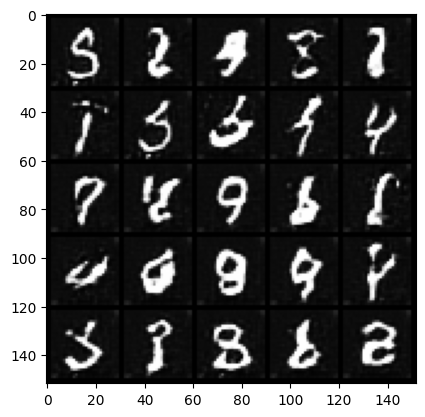

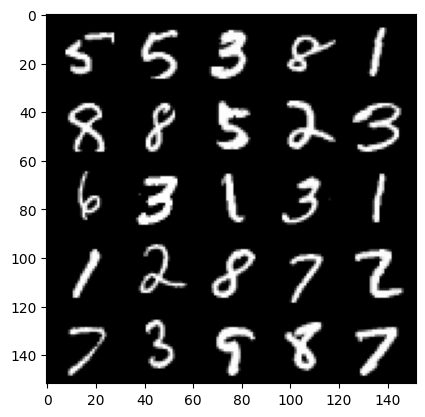

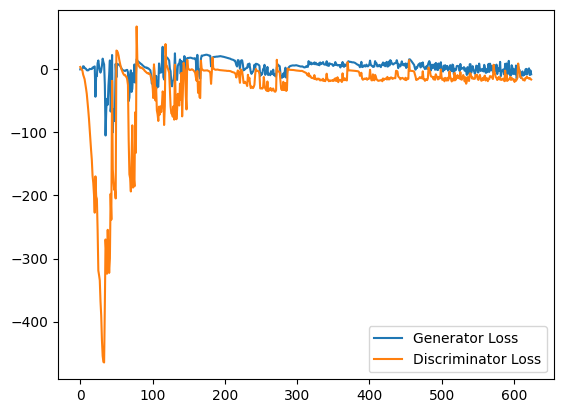

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 27, step 13000: Generator loss: -4.7111657301038505, discriminator loss: -9.936402709746362


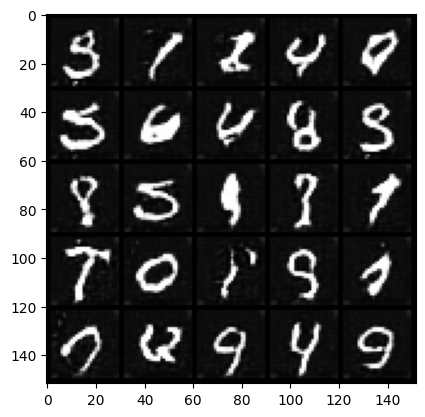

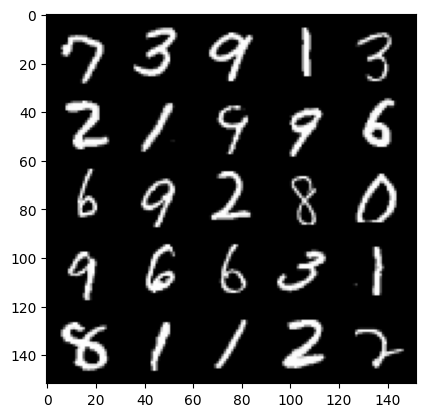

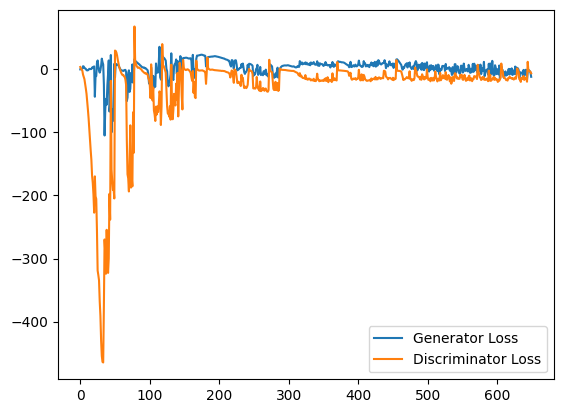

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 28, step 13500: Generator loss: -8.71617170843482, discriminator loss: -14.508759917545317


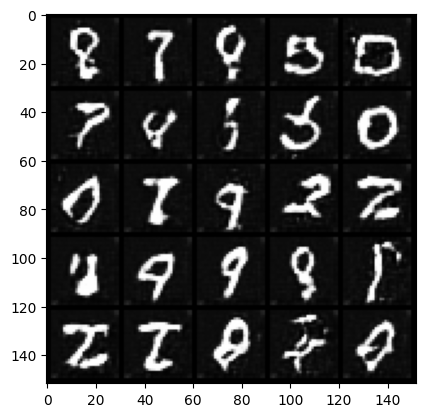

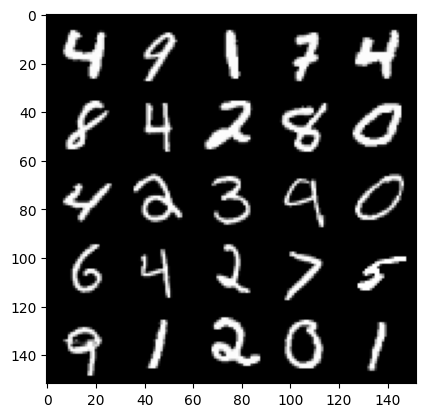

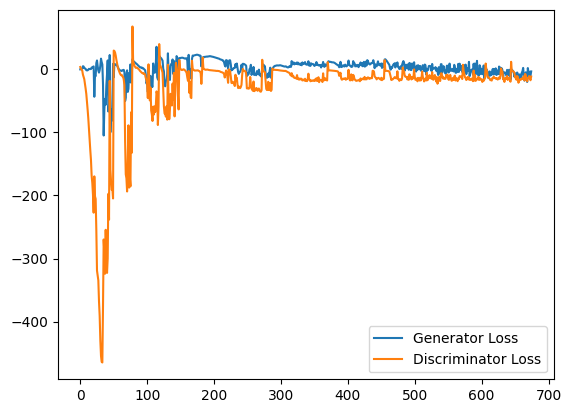

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 29, step 14000: Generator loss: -10.435200911581516, discriminator loss: -13.919258421802523


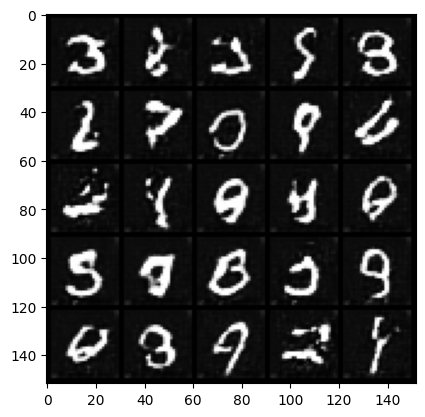

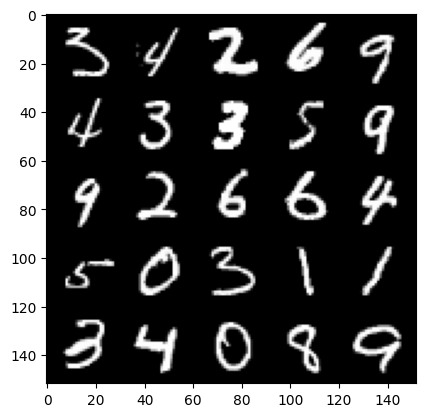

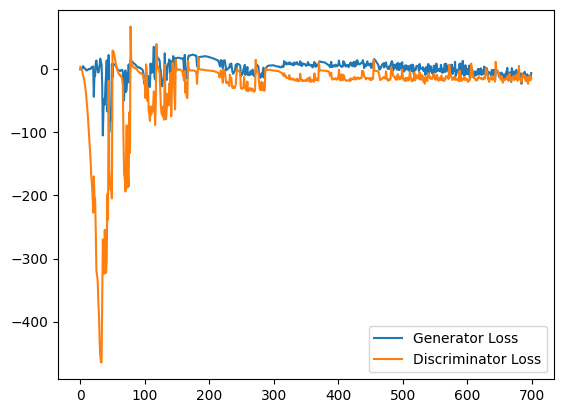

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 30, step 14500: Generator loss: -10.811386897534131, discriminator loss: -11.83499974420072


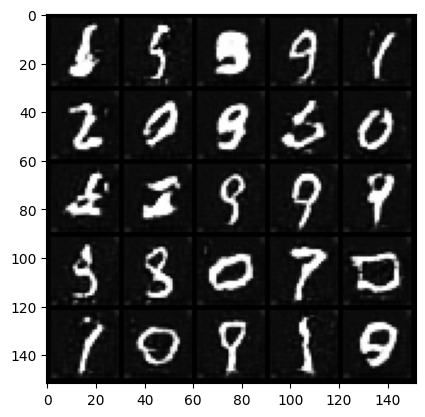

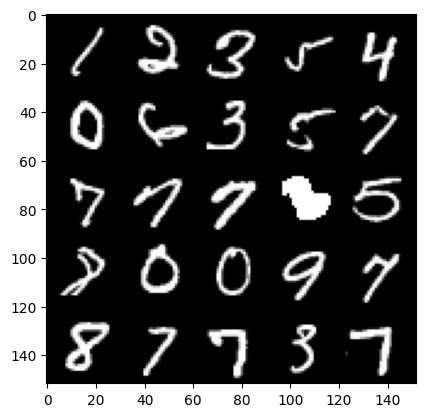

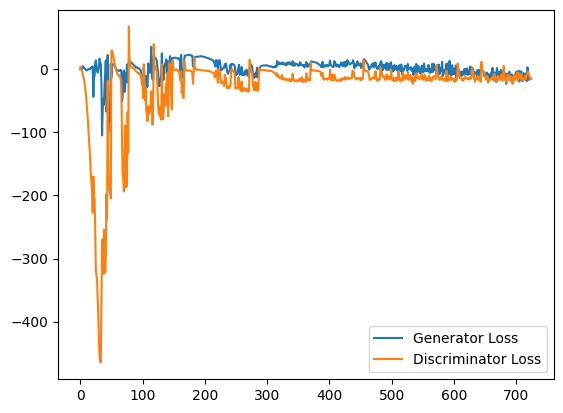

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 31, step 15000: Generator loss: -10.464327116757632, discriminator loss: -13.416784279751782


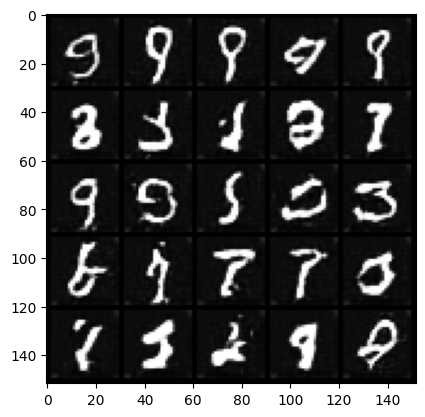

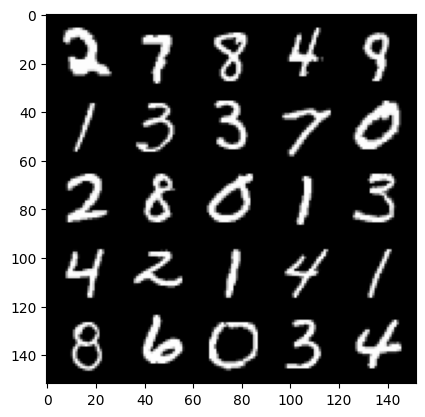

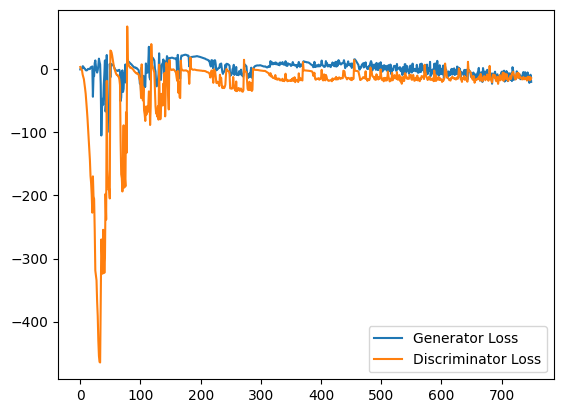

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 33, step 15500: Generator loss: -12.247949527174235, discriminator loss: -11.475994361197955


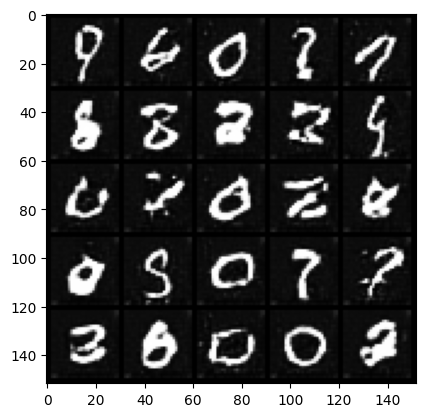

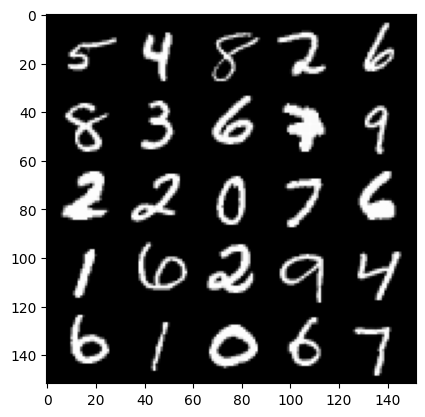

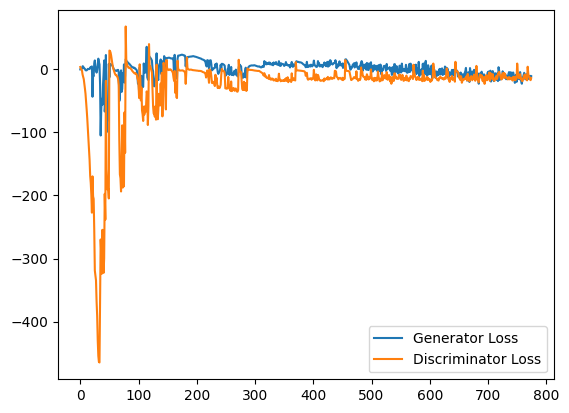

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 34, step 16000: Generator loss: -11.850592185646295, discriminator loss: -10.146042602181431


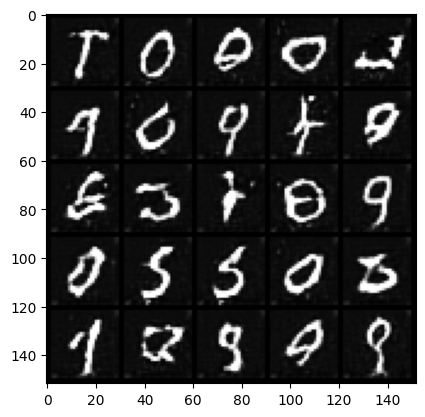

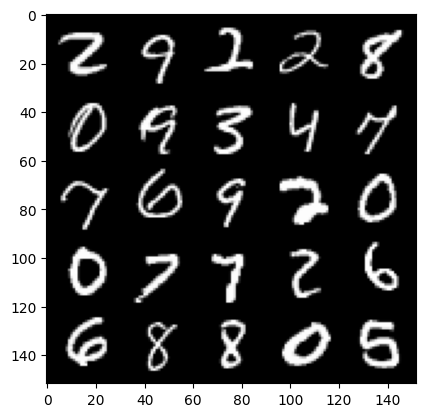

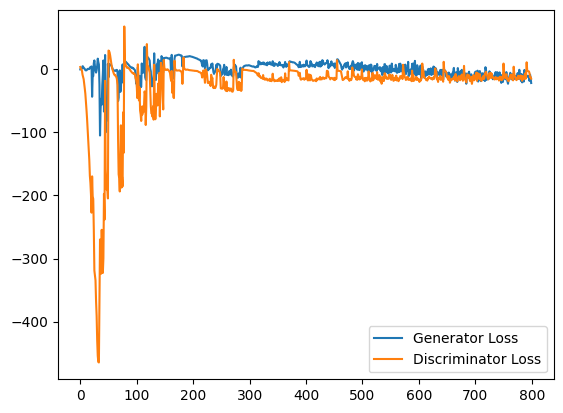

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 35, step 16500: Generator loss: -12.517057590305805, discriminator loss: -12.745593701744081


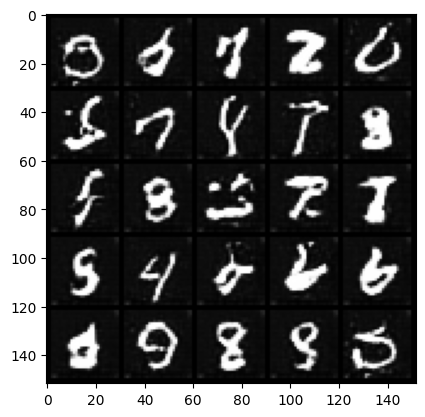

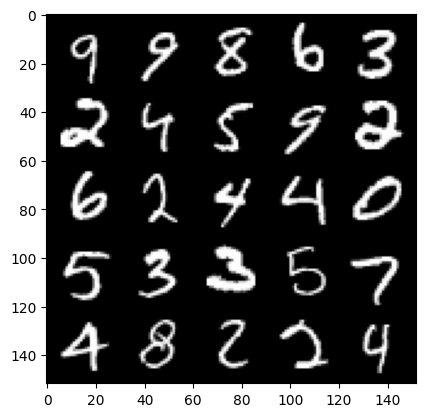

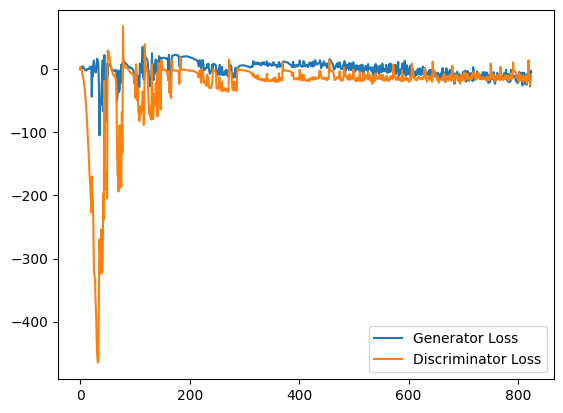

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 36, step 17000: Generator loss: -13.768525615364313, discriminator loss: -14.086241627812397


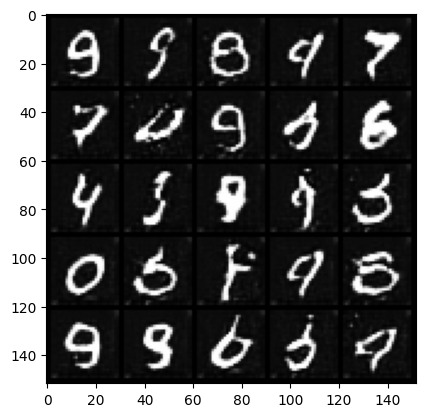

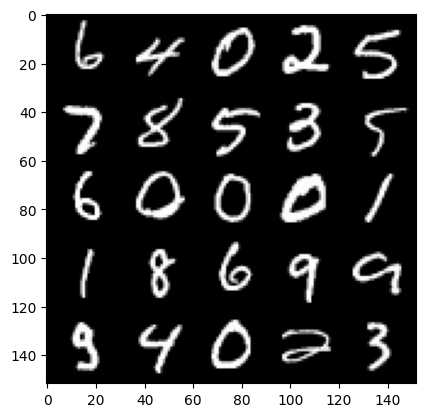

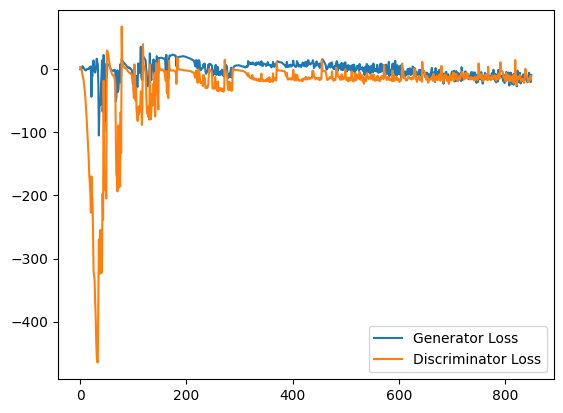

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 37, step 17500: Generator loss: -13.459697548910976, discriminator loss: -13.446519675731663


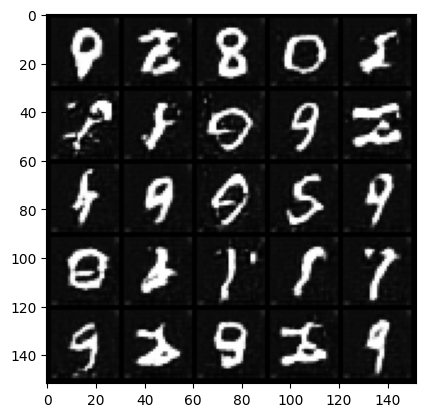

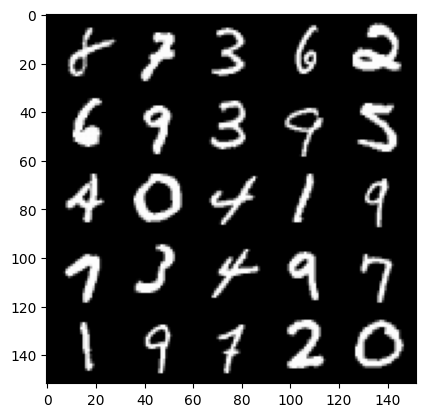

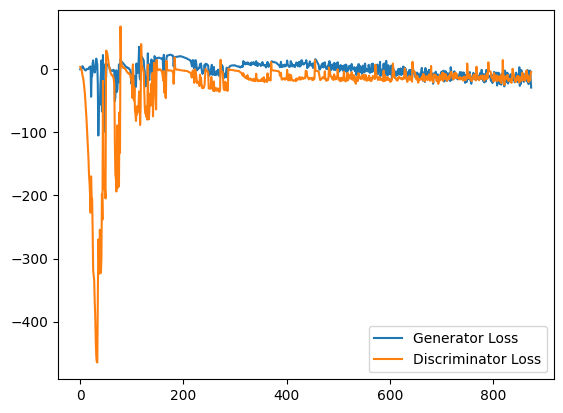

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 38, step 18000: Generator loss: -14.116477538466453, discriminator loss: -11.016426417756067


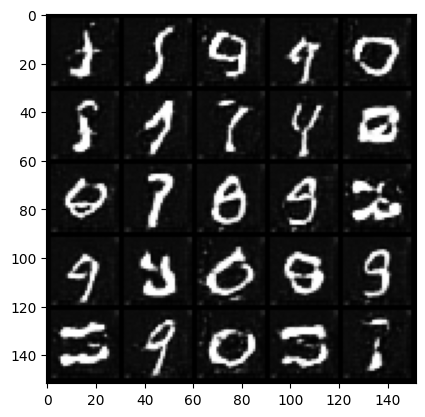

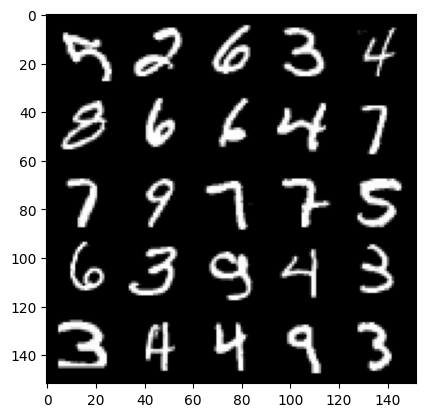

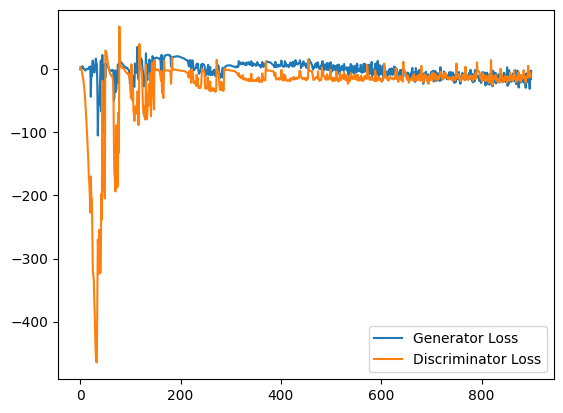

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 39, step 18500: Generator loss: -17.242934107750653, discriminator loss: -14.079514485621463


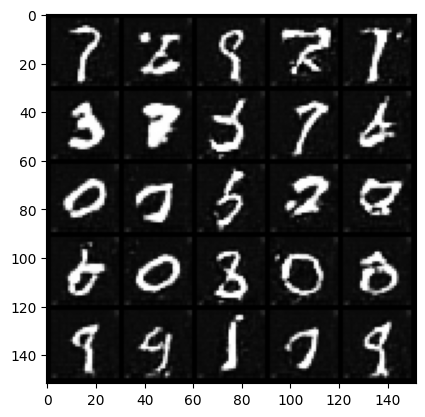

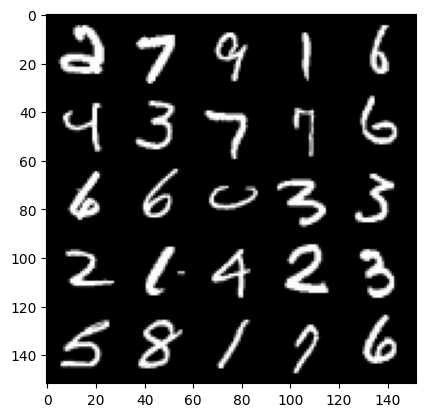

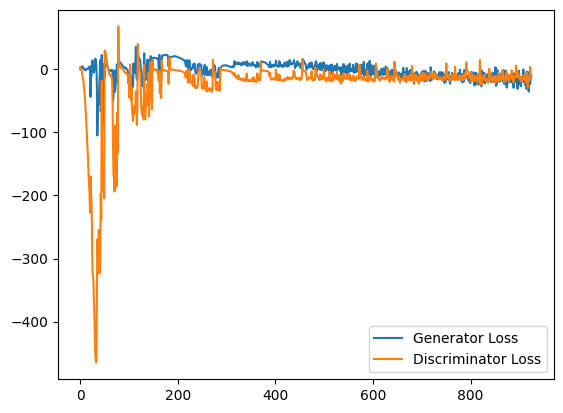

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 40, step 19000: Generator loss: -18.203412566512824, discriminator loss: -10.969412150239942


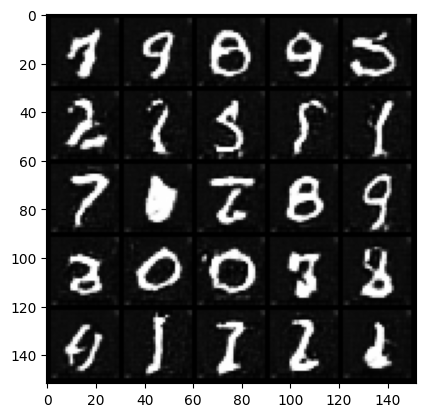

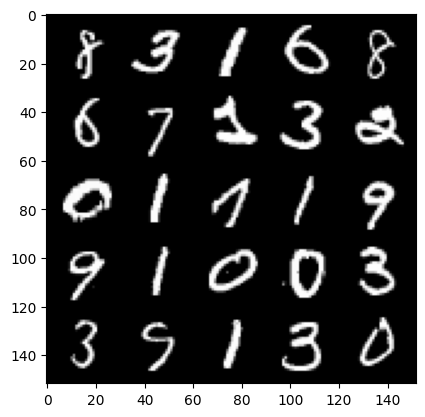

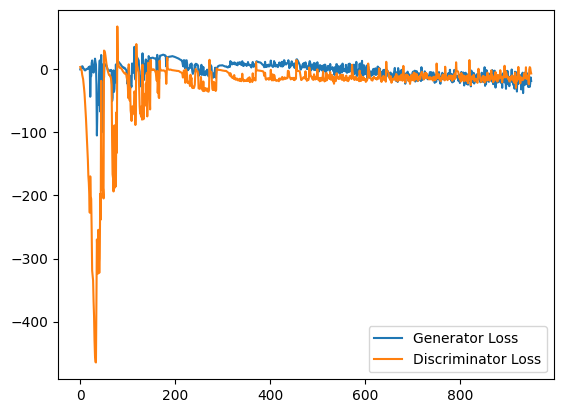

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 41, step 19500: Generator loss: -17.636885173916816, discriminator loss: -13.430896321058277


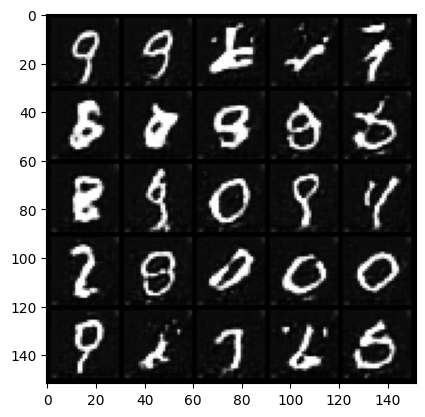

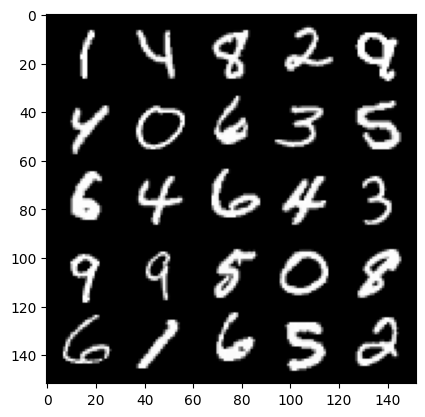

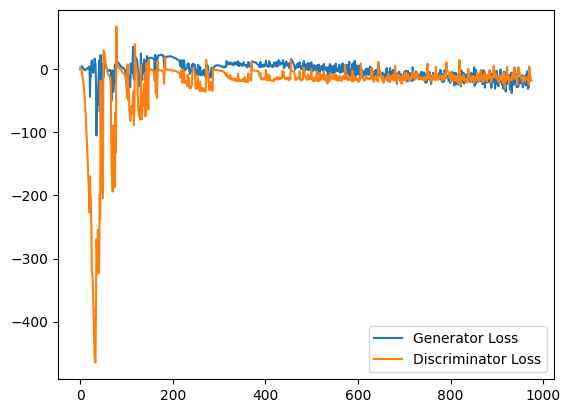

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 42, step 20000: Generator loss: -18.144709167867898, discriminator loss: -14.205788022208203


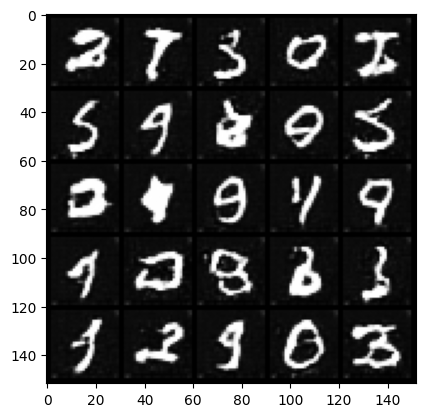

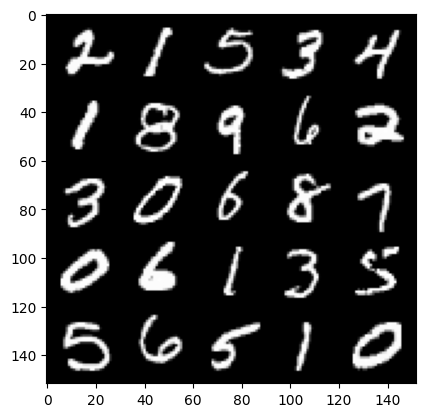

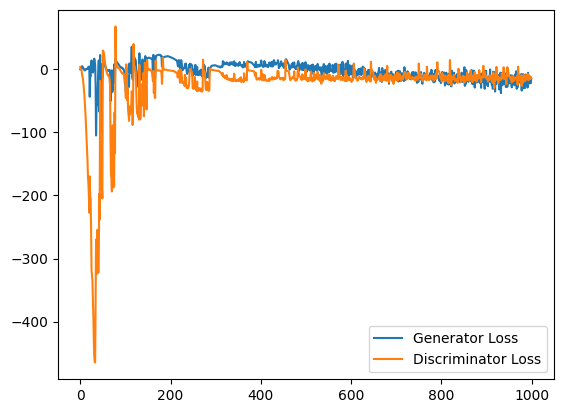

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 43, step 20500: Generator loss: -20.482065386906267, discriminator loss: -13.429351985573772


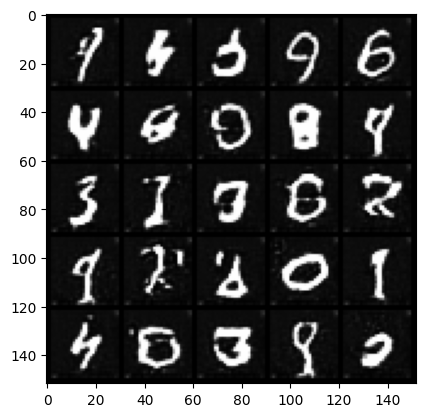

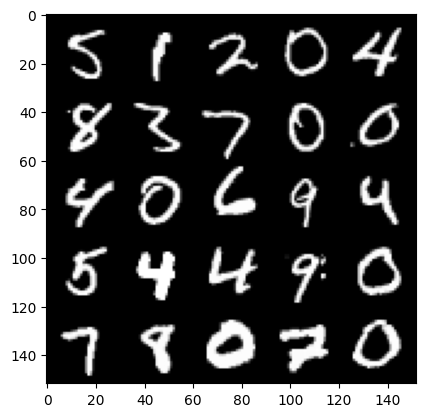

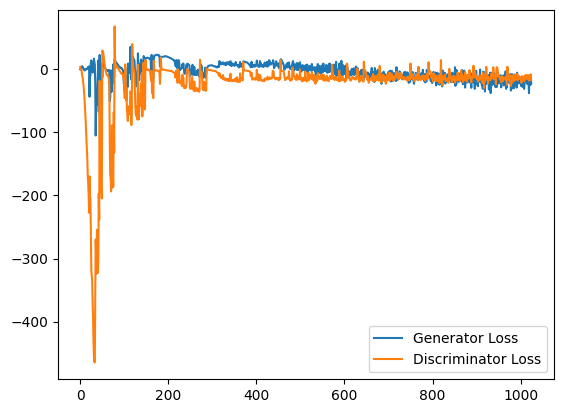

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 44, step 21000: Generator loss: -22.571321194529535, discriminator loss: -11.653350021433821


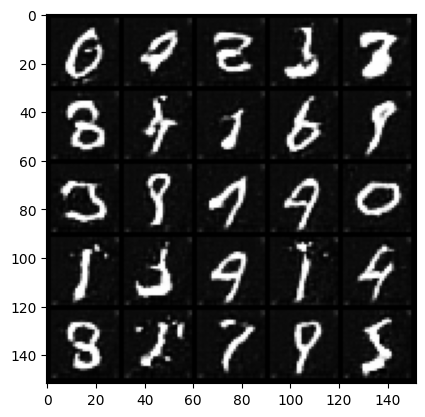

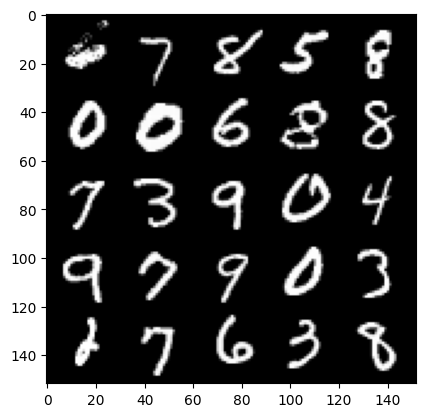

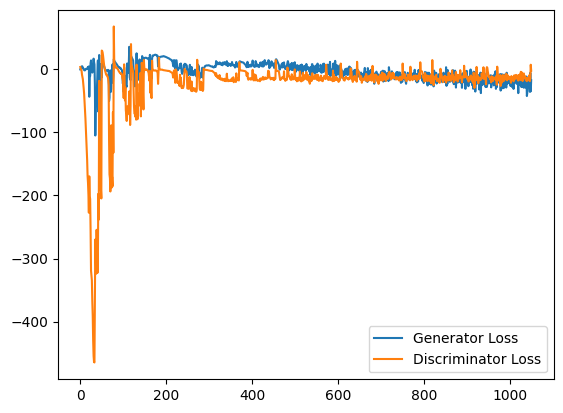

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 45, step 21500: Generator loss: -24.673097610235214, discriminator loss: -12.471369010376927


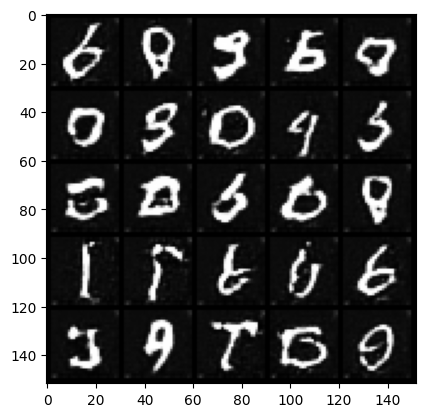

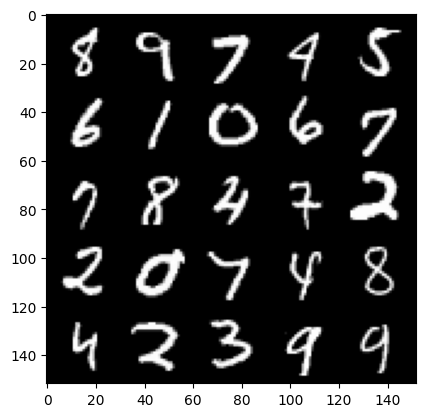

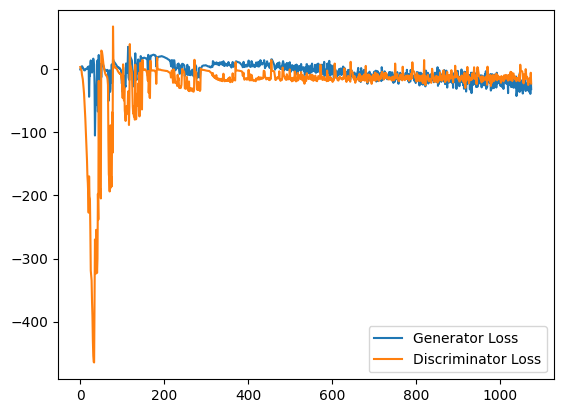

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 46, step 22000: Generator loss: -23.592972530841827, discriminator loss: -13.025101249980935


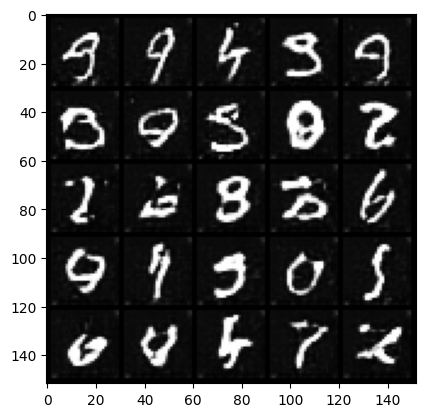

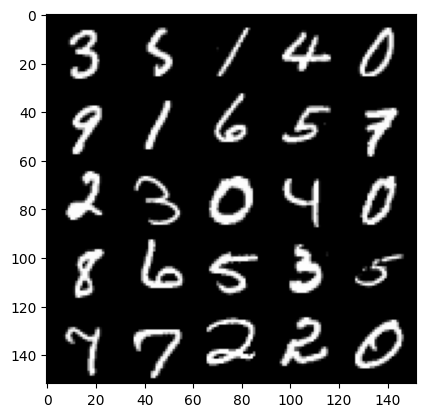

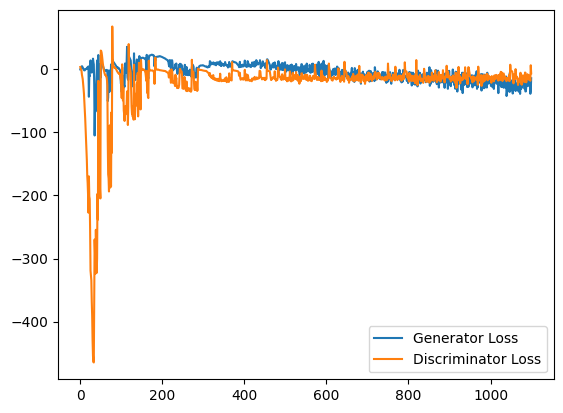

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 47, step 22500: Generator loss: -24.324036358475684, discriminator loss: -13.149184289419637


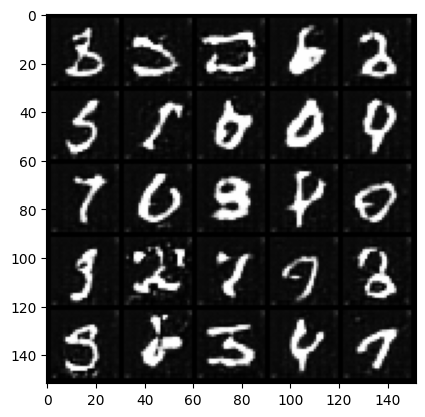

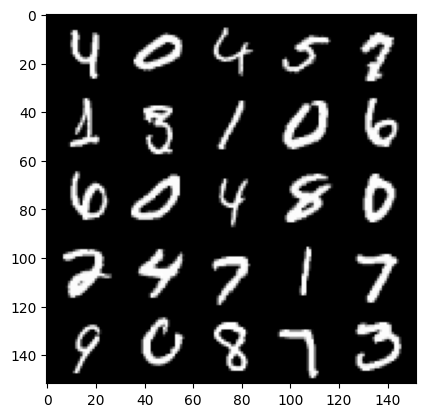

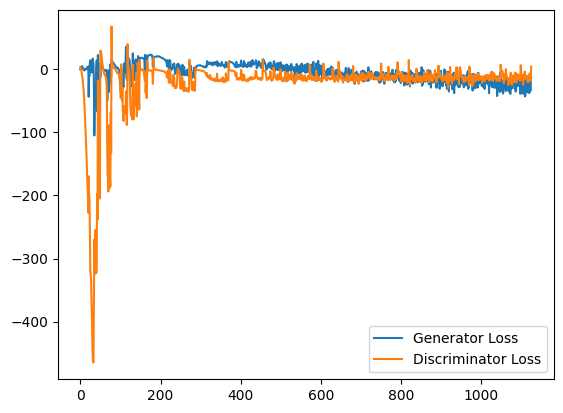

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 49, step 23000: Generator loss: -25.635686370670797, discriminator loss: -13.037310816121094


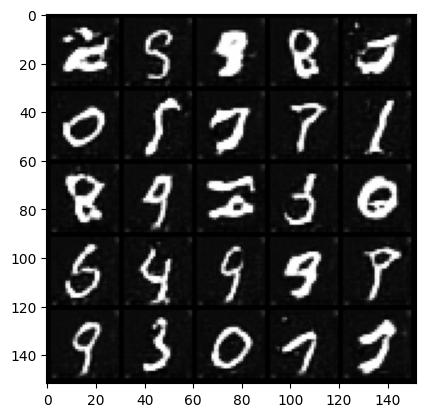

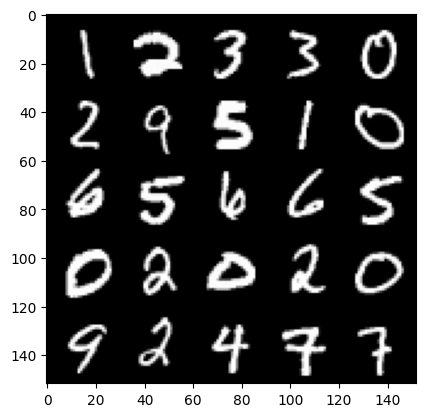

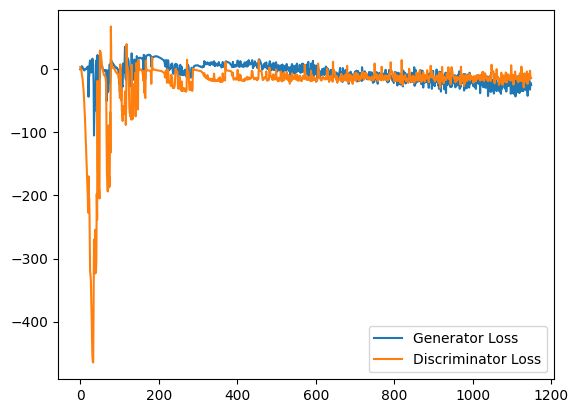

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 50, step 23500: Generator loss: -24.51974392053485, discriminator loss: -14.829866076445567


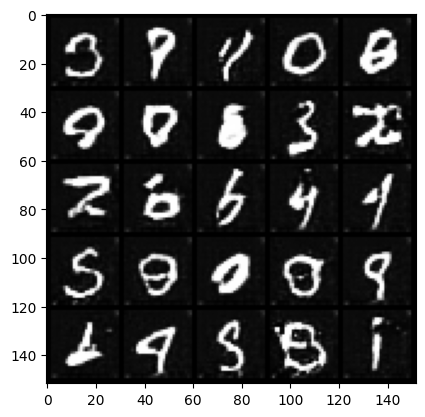

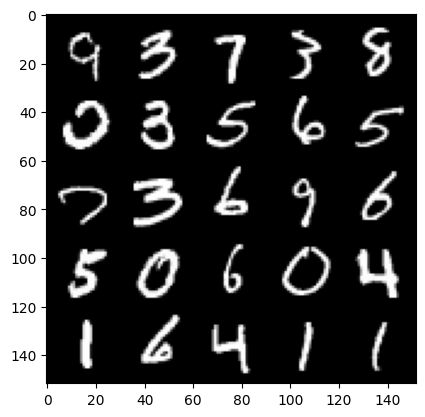

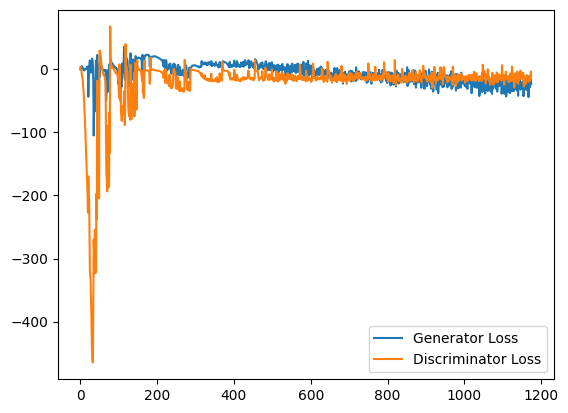

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 51, step 24000: Generator loss: -25.69599527132511, discriminator loss: -12.073557802426818


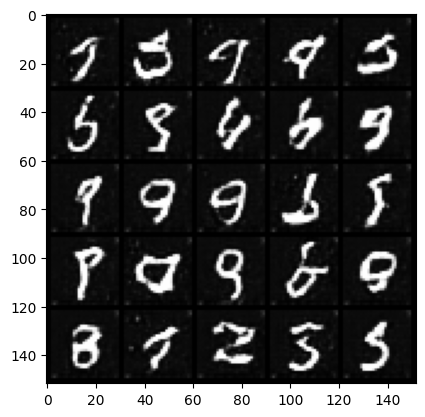

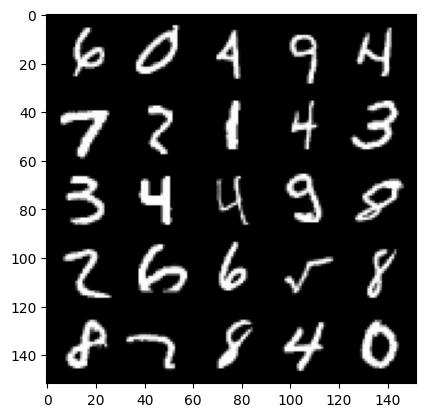

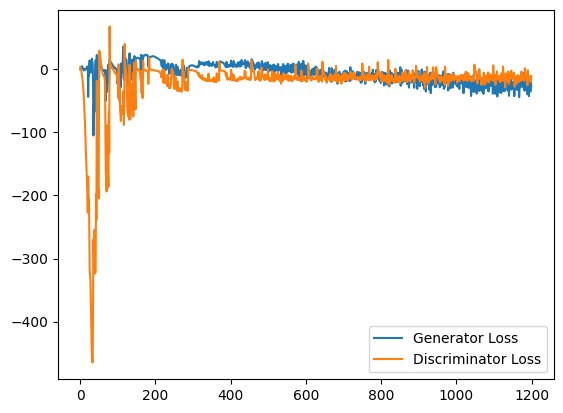

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 52, step 24500: Generator loss: -27.266213986456393, discriminator loss: -13.29734024871588


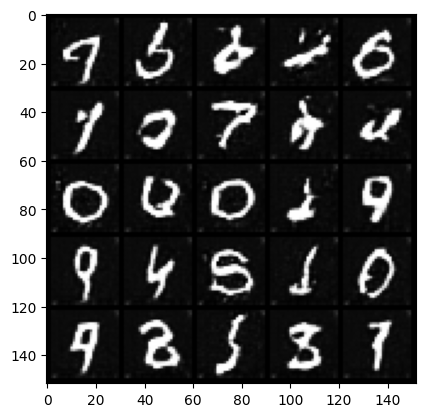

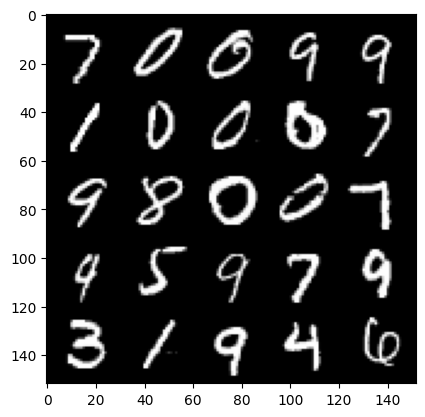

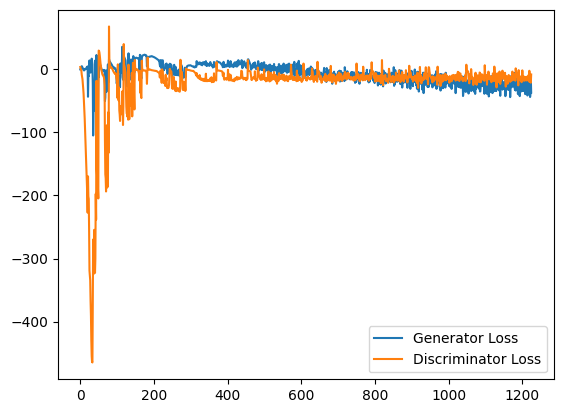

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 53, step 25000: Generator loss: -25.40595033252239, discriminator loss: -12.20638155074119


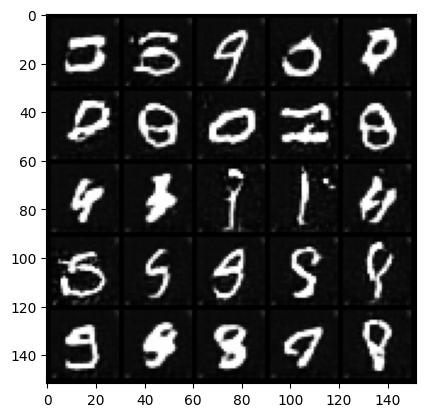

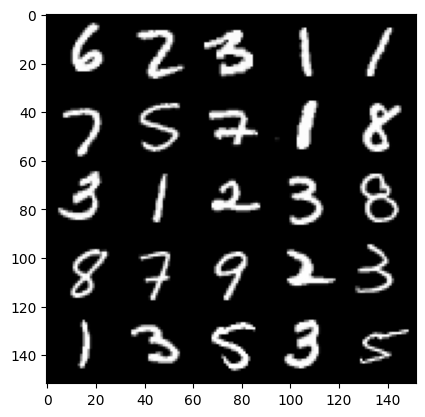

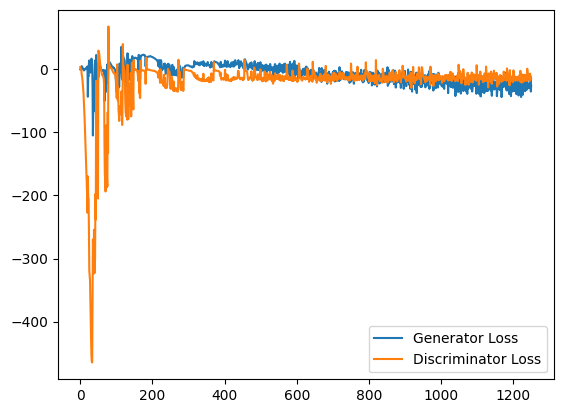

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 54, step 25500: Generator loss: -24.9859690246284, discriminator loss: -14.328815700304501


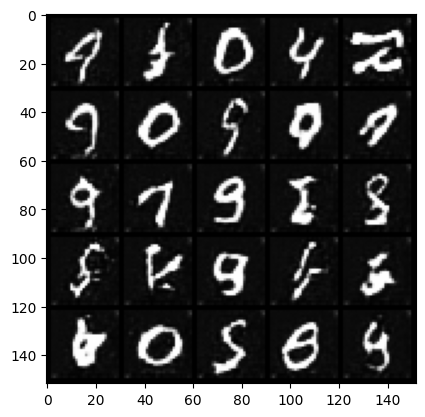

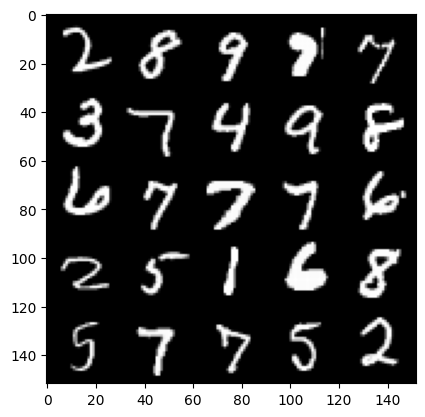

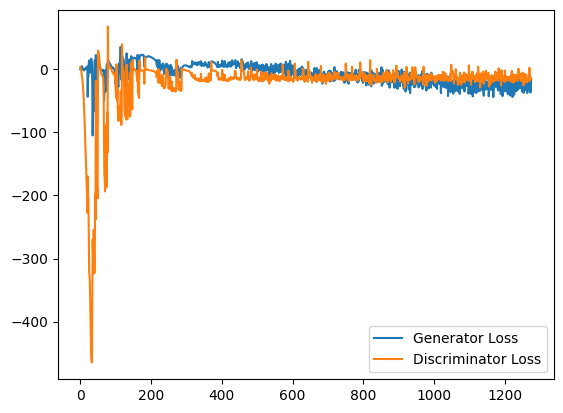

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 55, step 26000: Generator loss: -27.445785228192808, discriminator loss: -14.603204491329203


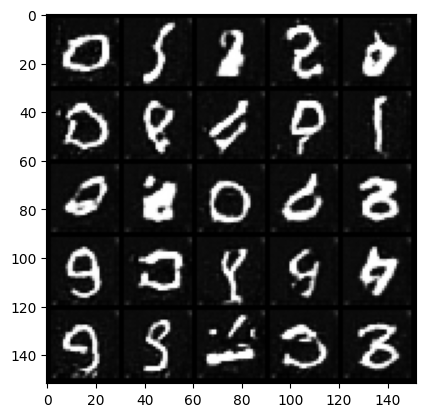

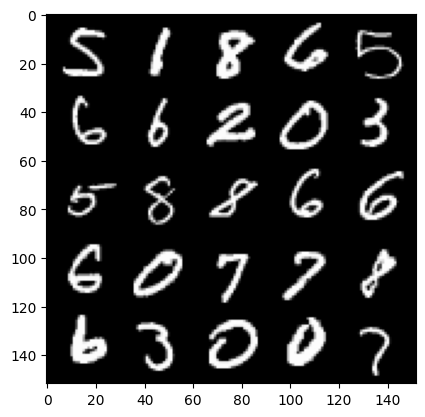

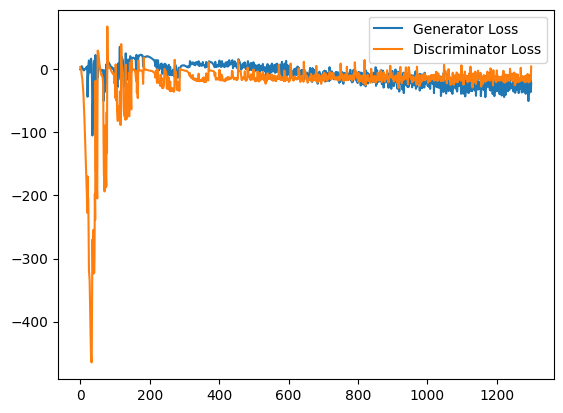

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 56, step 26500: Generator loss: -25.52977646586299, discriminator loss: -12.389723149847994


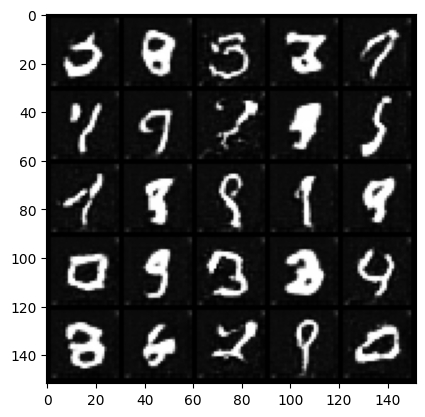

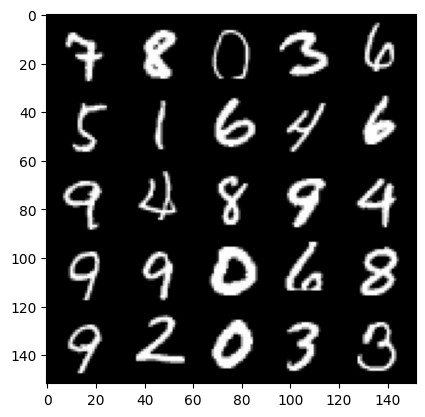

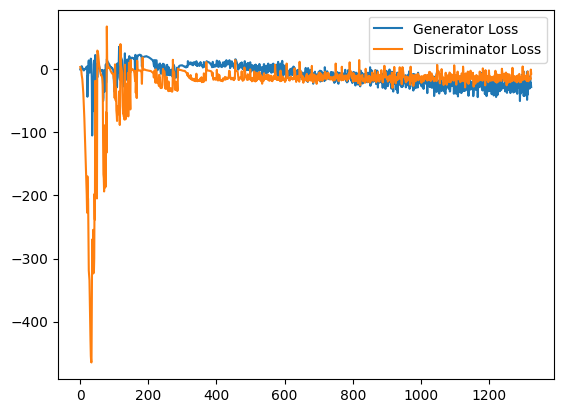

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 57, step 27000: Generator loss: -26.980146564930678, discriminator loss: -12.721296306324005


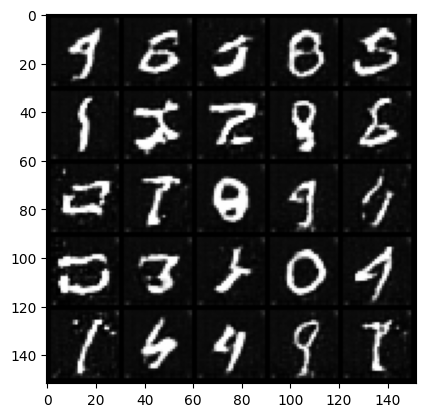

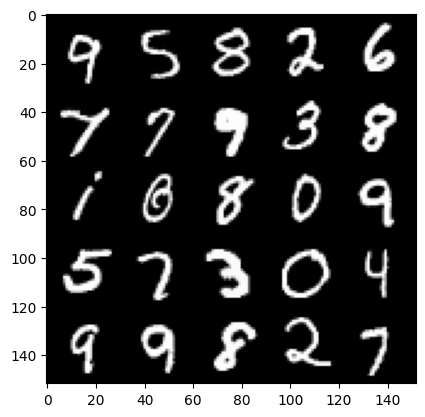

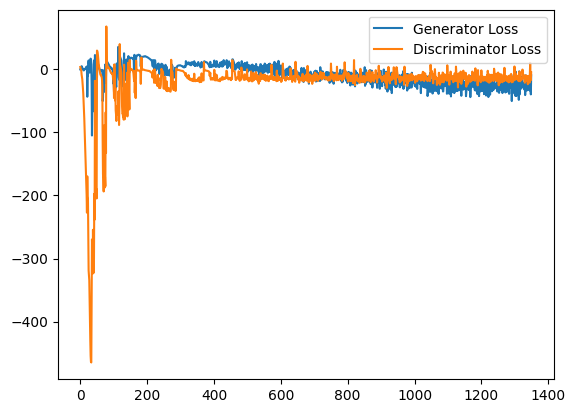

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 58, step 27500: Generator loss: -26.376137321174145, discriminator loss: -12.686160068583465


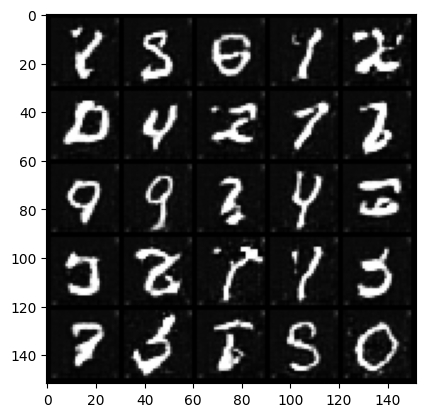

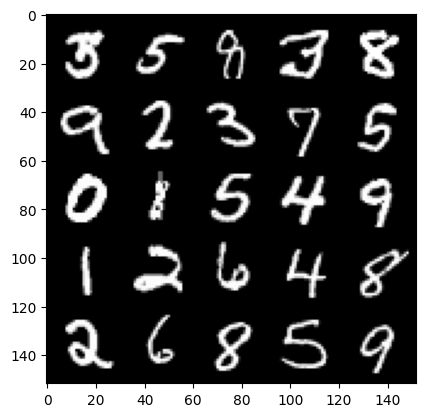

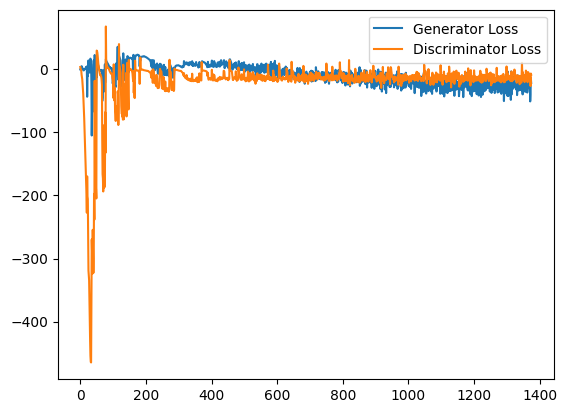

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 59, step 28000: Generator loss: -27.169803703308105, discriminator loss: -13.062491486120214


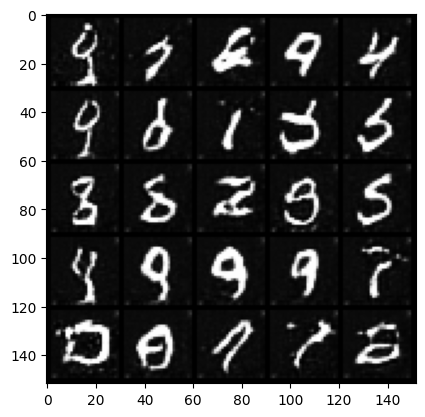

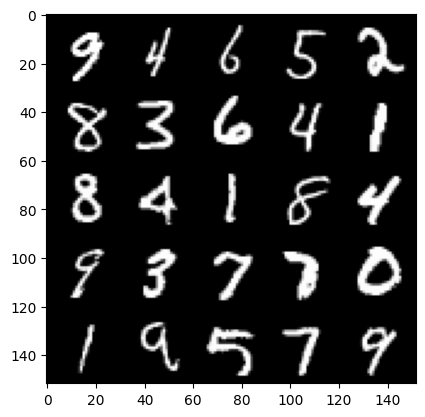

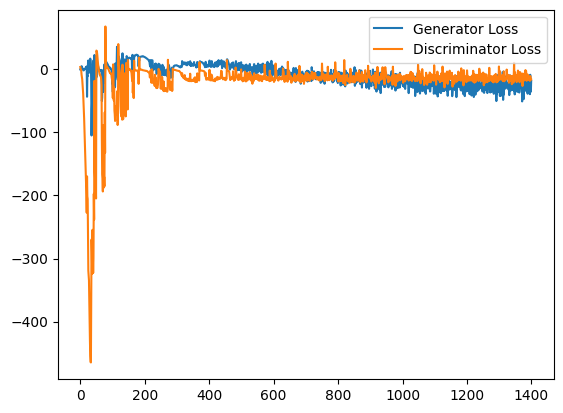

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 60, step 28500: Generator loss: -28.30364314082265, discriminator loss: -14.061942487049102


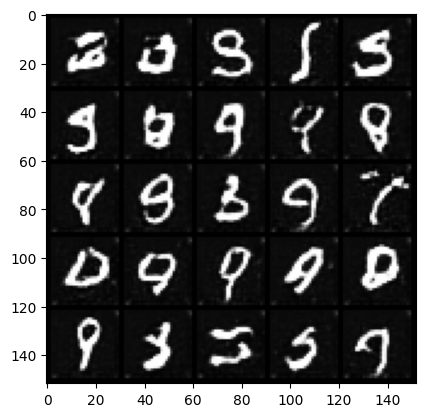

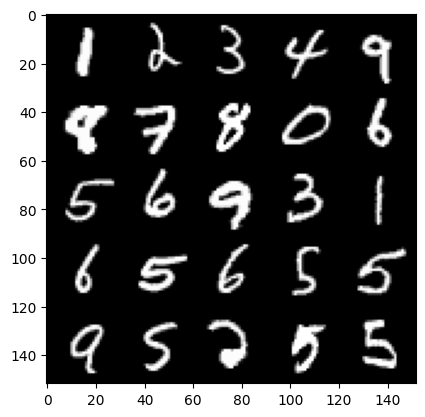

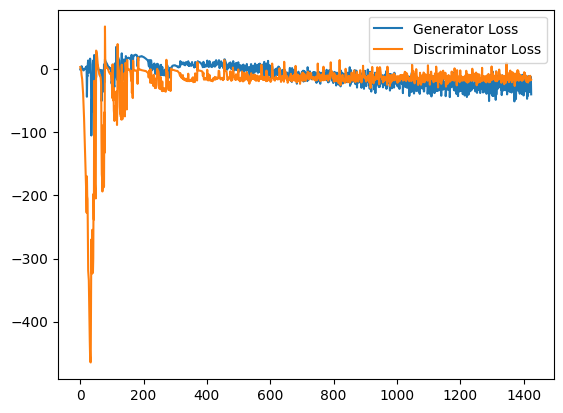

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 61, step 29000: Generator loss: -27.227847716748716, discriminator loss: -12.747366101670263


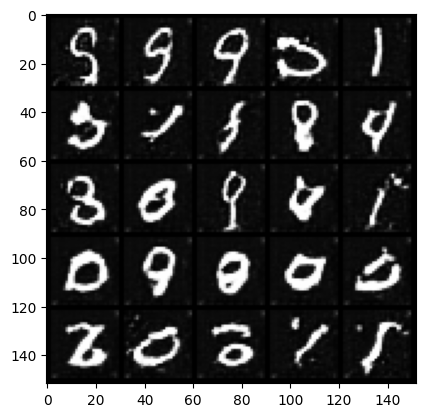

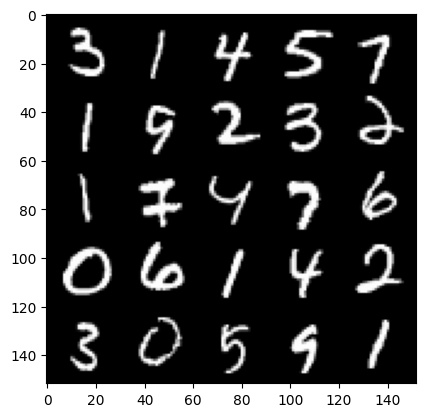

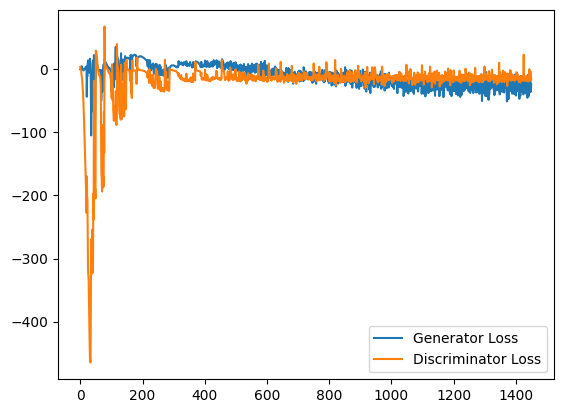

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 62, step 29500: Generator loss: -25.760684109926224, discriminator loss: -14.781839917743211


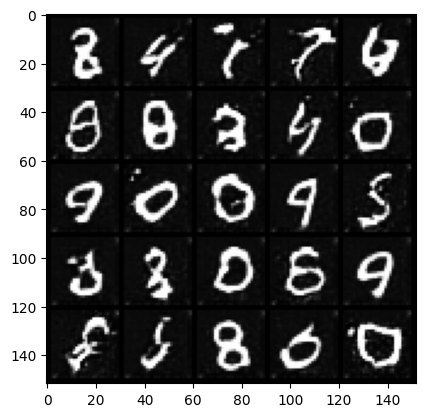

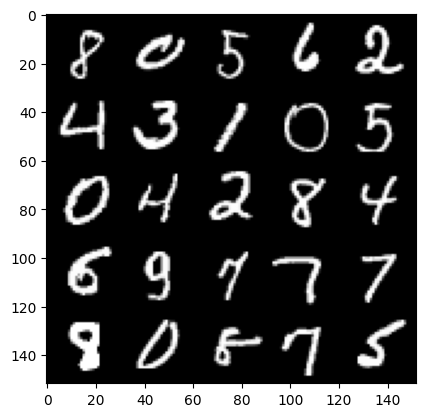

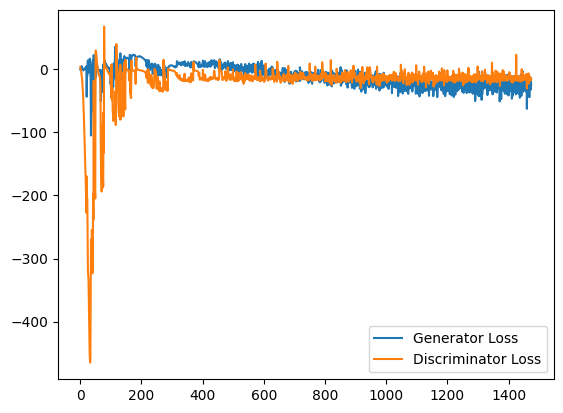

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 63, step 30000: Generator loss: -29.113287903755904, discriminator loss: -15.755689671337594


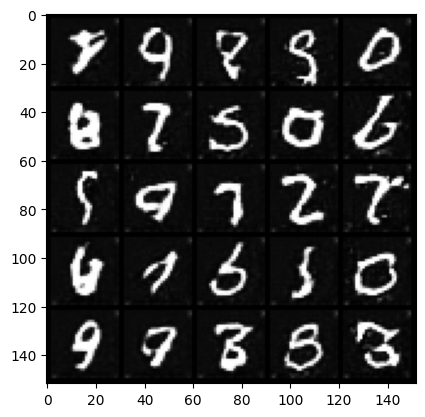

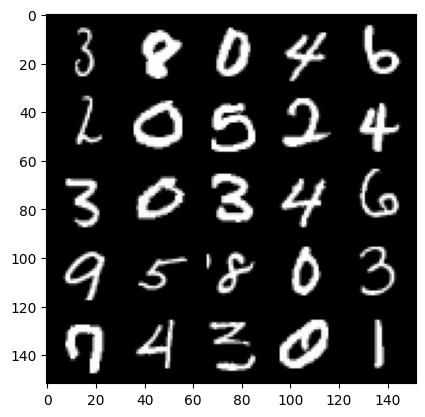

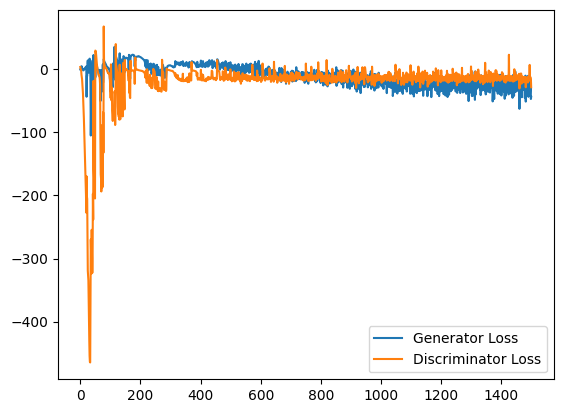

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 65, step 30500: Generator loss: -27.038295312345028, discriminator loss: -12.221484032928943


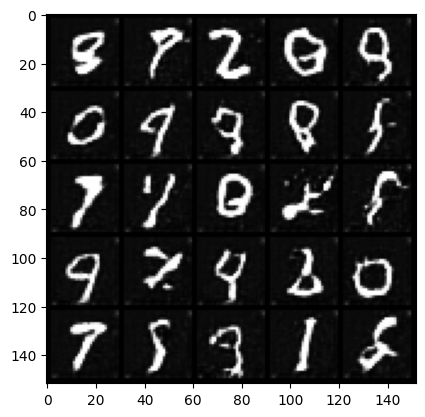

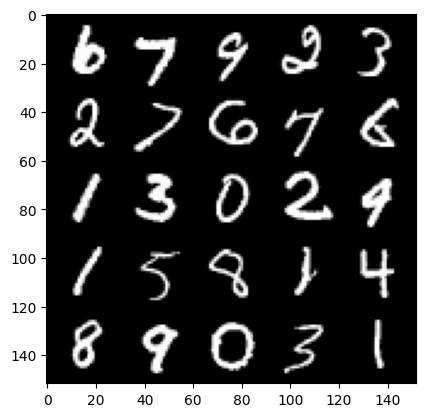

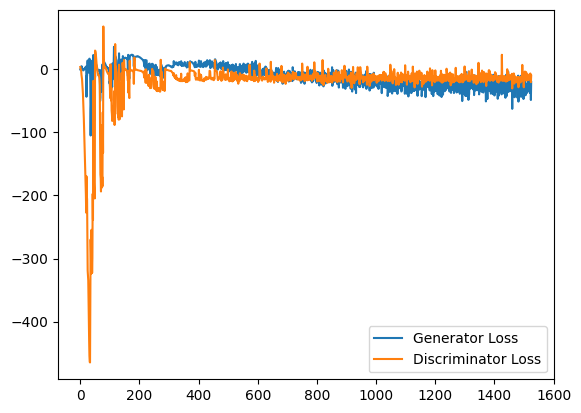

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 66, step 31000: Generator loss: -30.915406522393226, discriminator loss: -15.401996152865884


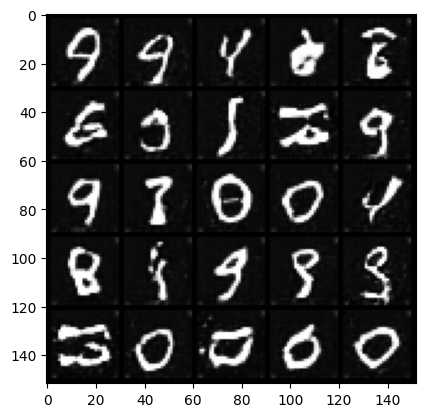

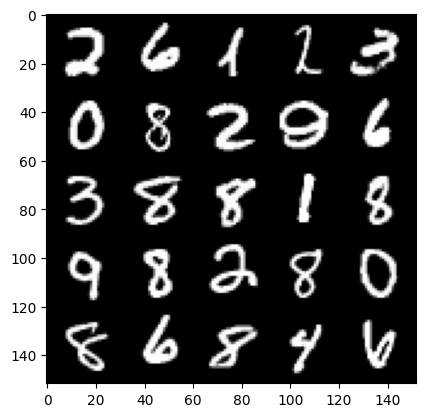

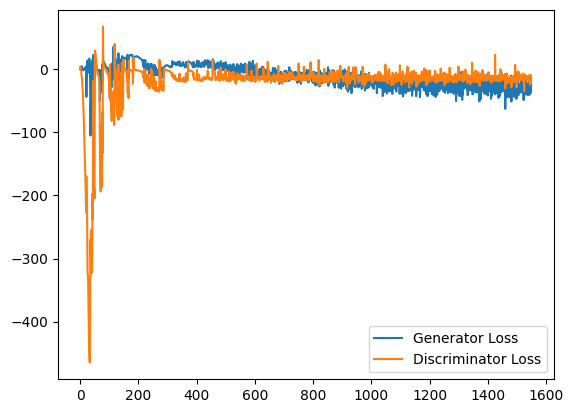

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 67, step 31500: Generator loss: -32.46257080960274, discriminator loss: -13.819084414637086


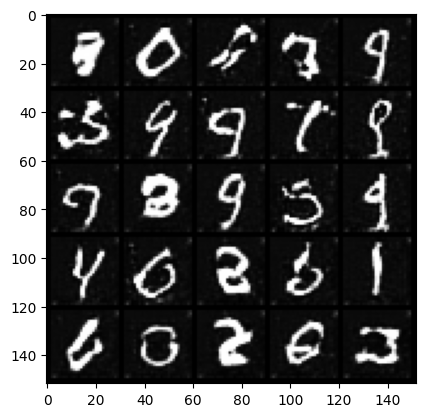

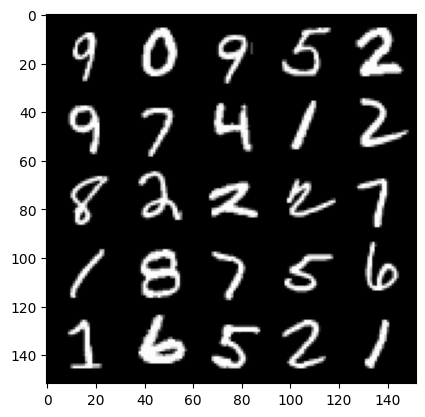

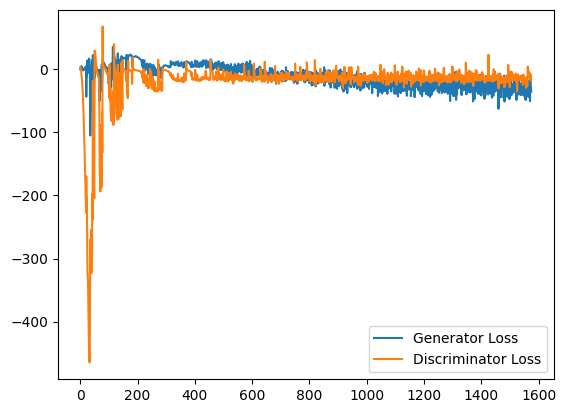

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 68, step 32000: Generator loss: -30.131009515881537, discriminator loss: -14.09315033613444


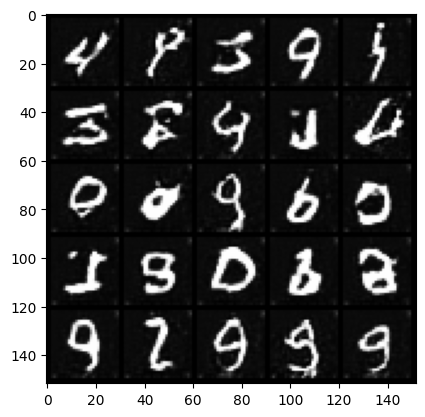

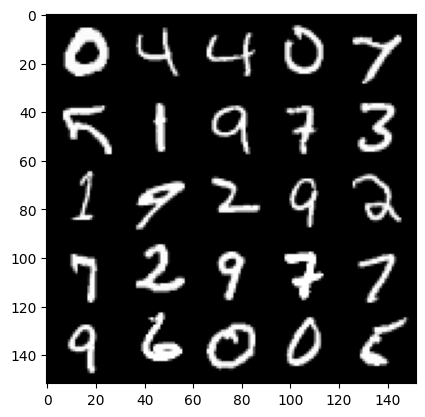

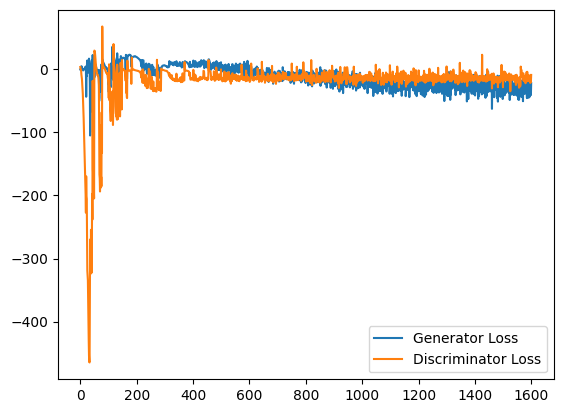

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 69, step 32500: Generator loss: -32.099782767236235, discriminator loss: -14.067205352032174


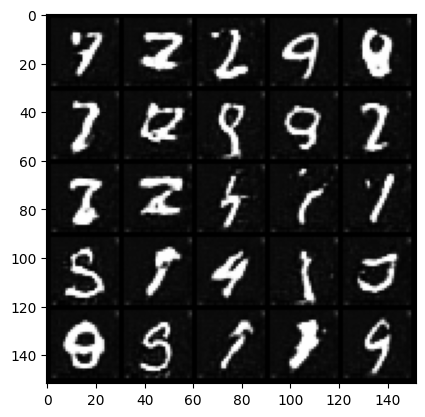

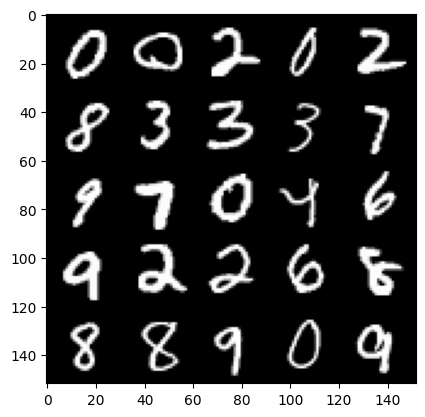

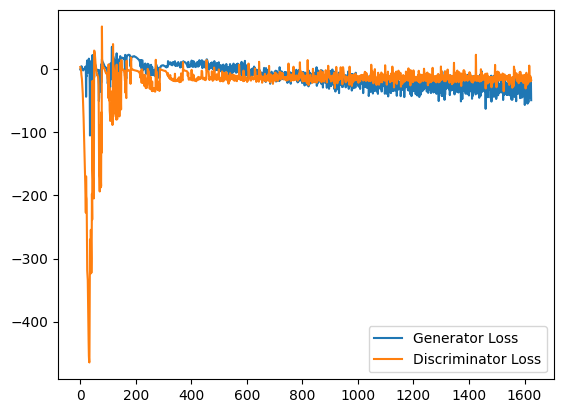

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 70, step 33000: Generator loss: -30.267532082915306, discriminator loss: -13.780909117484102


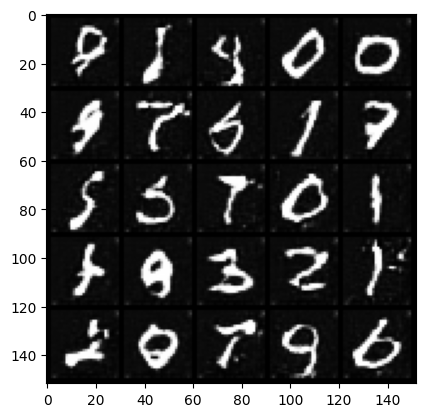

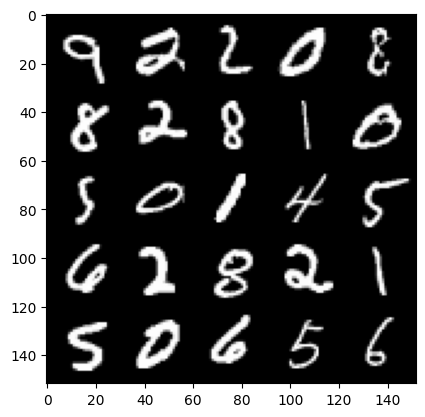

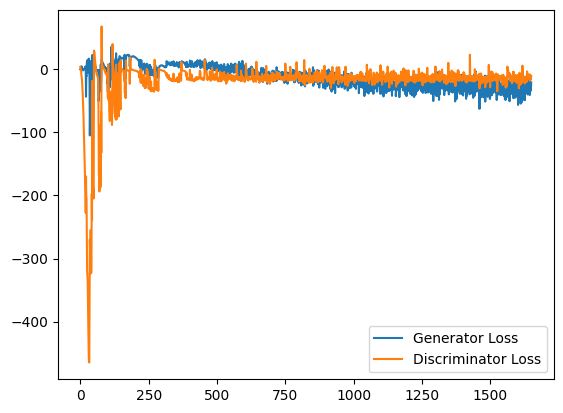

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 71, step 33500: Generator loss: -33.28513284552098, discriminator loss: -10.600418620824817


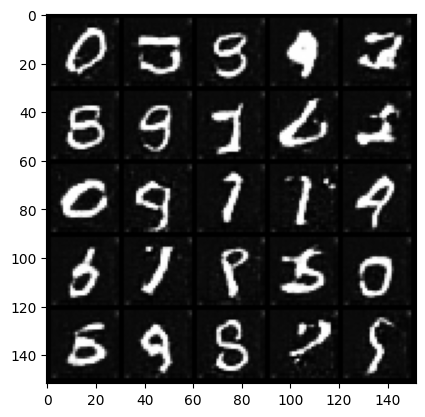

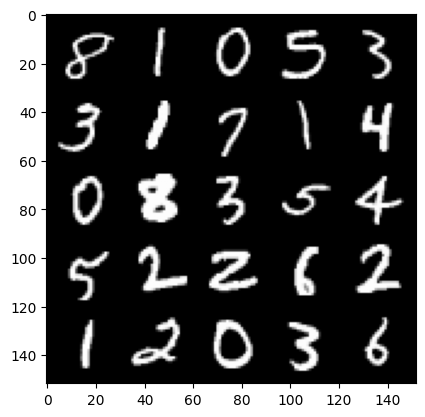

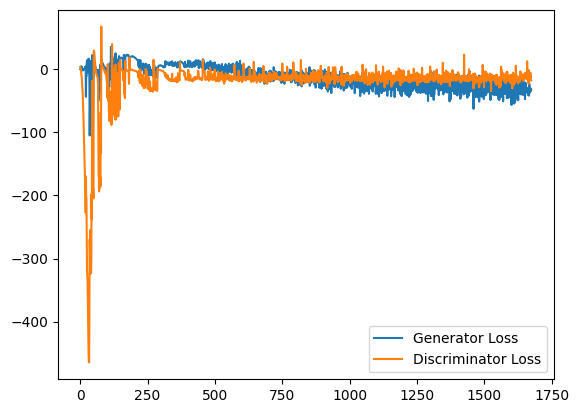

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 72, step 34000: Generator loss: -34.95182408750057, discriminator loss: -15.823200536406041


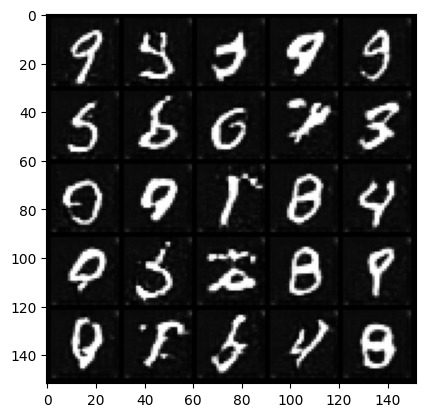

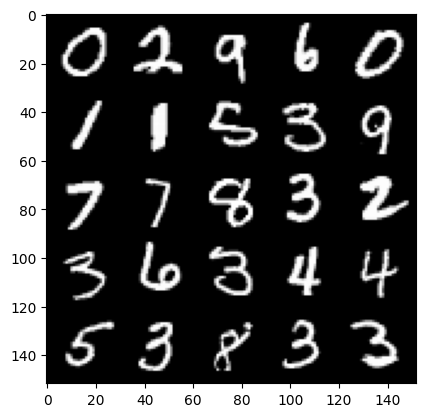

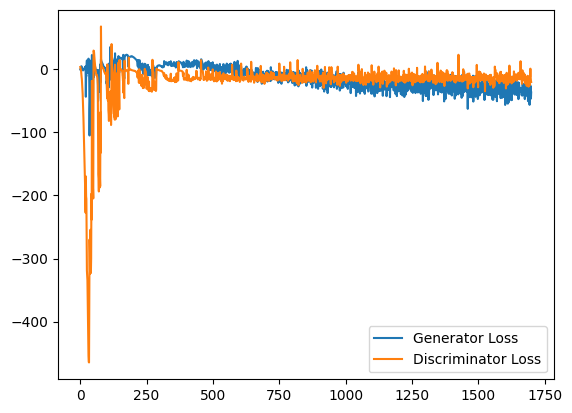

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 73, step 34500: Generator loss: -33.84536267793179, discriminator loss: -14.174761496496194


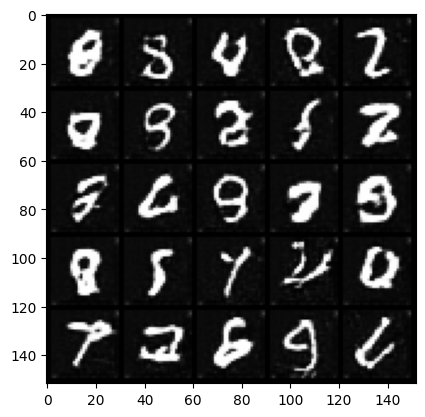

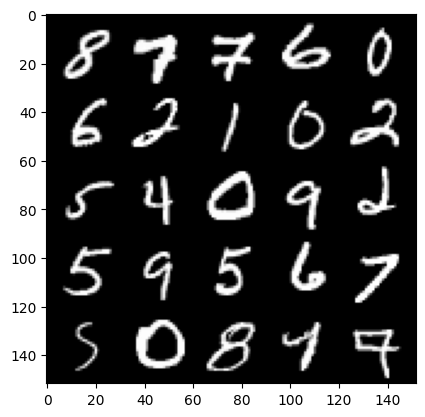

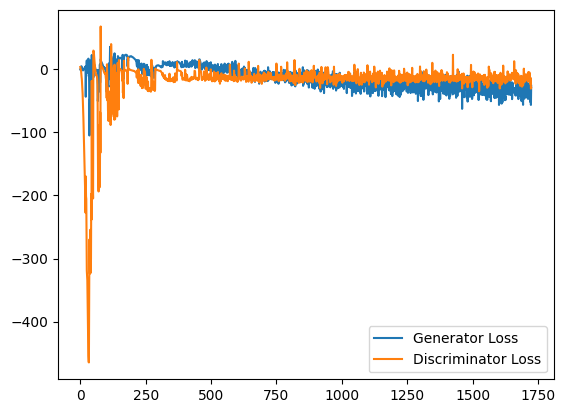

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 74, step 35000: Generator loss: -37.091725399374965, discriminator loss: -14.69041652545929


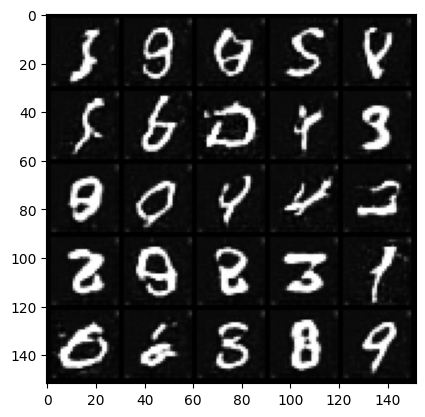

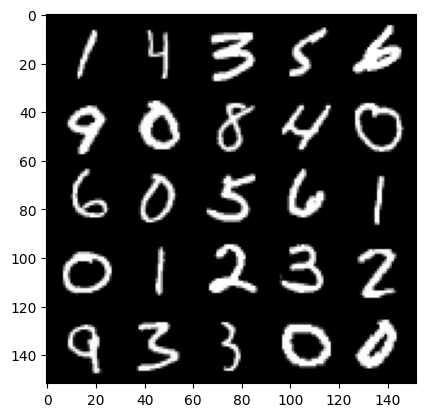

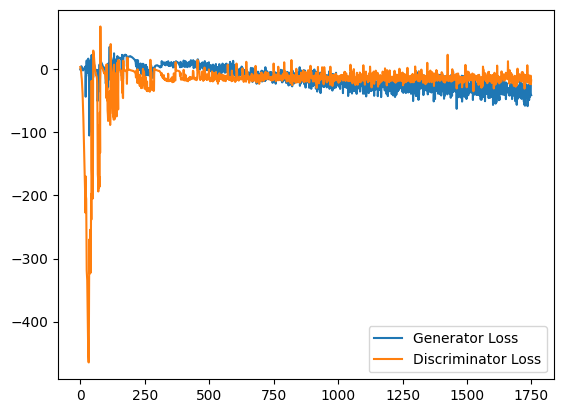

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 75, step 35500: Generator loss: -36.83686858141422, discriminator loss: -14.026004303574558


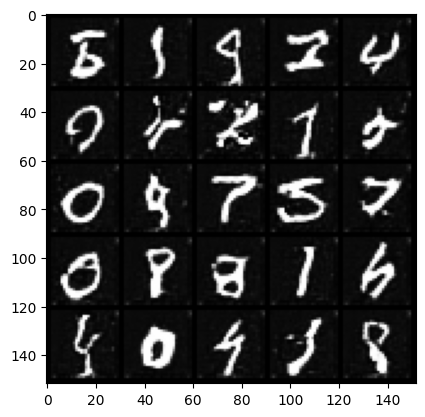

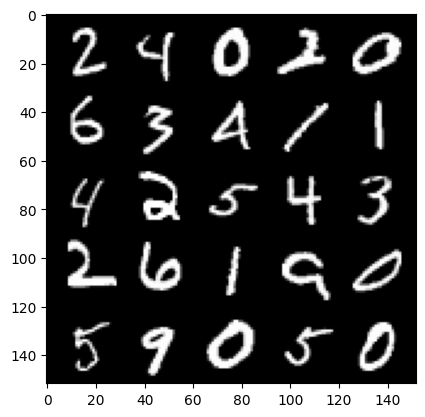

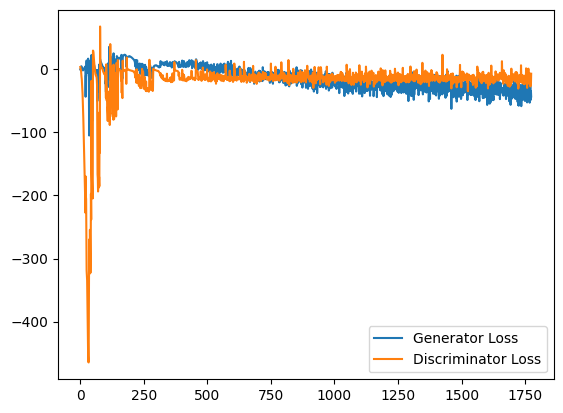

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 76, step 36000: Generator loss: -38.25146944230795, discriminator loss: -13.619767654442793


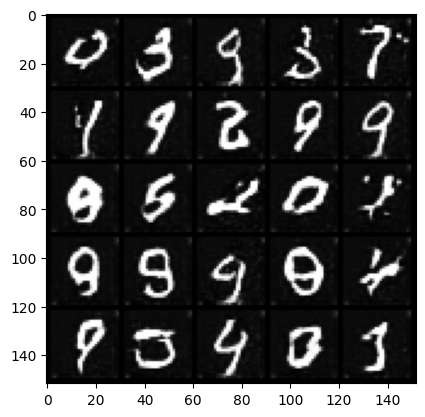

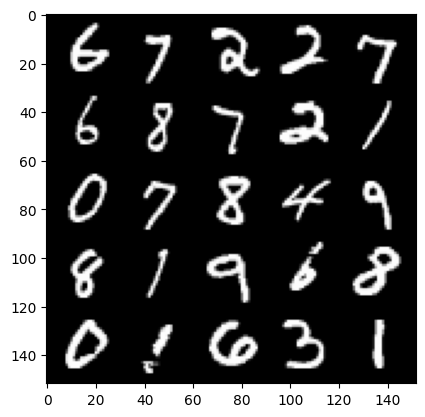

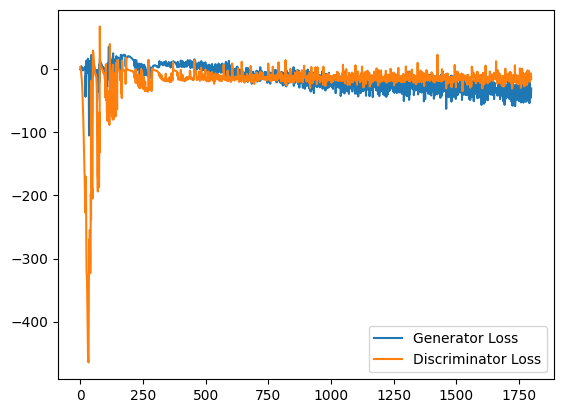

  0%|          | 0/469 [00:00<?, ?it/s]

In [ ]:
current_step = 0                # step count
generator_losses = []       # initialize empty
discriminator_losses = []          # initialize empty

# Training step for each epoch
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_discriminator_loss = 0
        for _ in range(discr_repeats):
            # Update the Discriminator
            discr_opt.zero_grad()
            fake_noise = torch.randn(cur_batch_size, noise_dim, device=device)
            fake = gen(fake_noise)
            discr_fake_pred = discr(fake.detach())
            discr_real_pred = discr(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            gradient = compute_gradient(discr, real, fake.detach(), epsilon)
            grad_penalty = gradient_penalty(gradient)
            discr_loss = compute_discr_loss(discr_fake_pred, discr_real_pred, grad_penalty, lambda_coeff)

            # Keep track of the average discriminator's loss in this batch
            mean_iteration_discriminator_loss += discr_loss.item() / discr_repeats
            # Update gradients
            discr_loss.backward(retain_graph=True)
            # Update optimizer
            discr_opt.step()
        discriminator_losses += [mean_iteration_discriminator_loss]

        # Update Generator
        gen_opt.zero_grad()
        fake_noise_2 = torch.randn(cur_batch_size, noise_dim, device=device)
        fake_2 = gen(fake_noise_2)
        discr_fake_pred = discr(fake_2)

        gen_loss = compute_gen_loss(discr_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        # Visualization code to see what is going on
        if current_step % display_step == 0 and current_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            discr_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Epoch {epoch}, step {current_step}: Generator loss: {gen_mean}, discriminator loss: {discr_mean}")
            show_images(fake)
            show_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins),
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins),
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()

        current_step += 1  # next step!